Preprocessing of the input images for WBC Detection

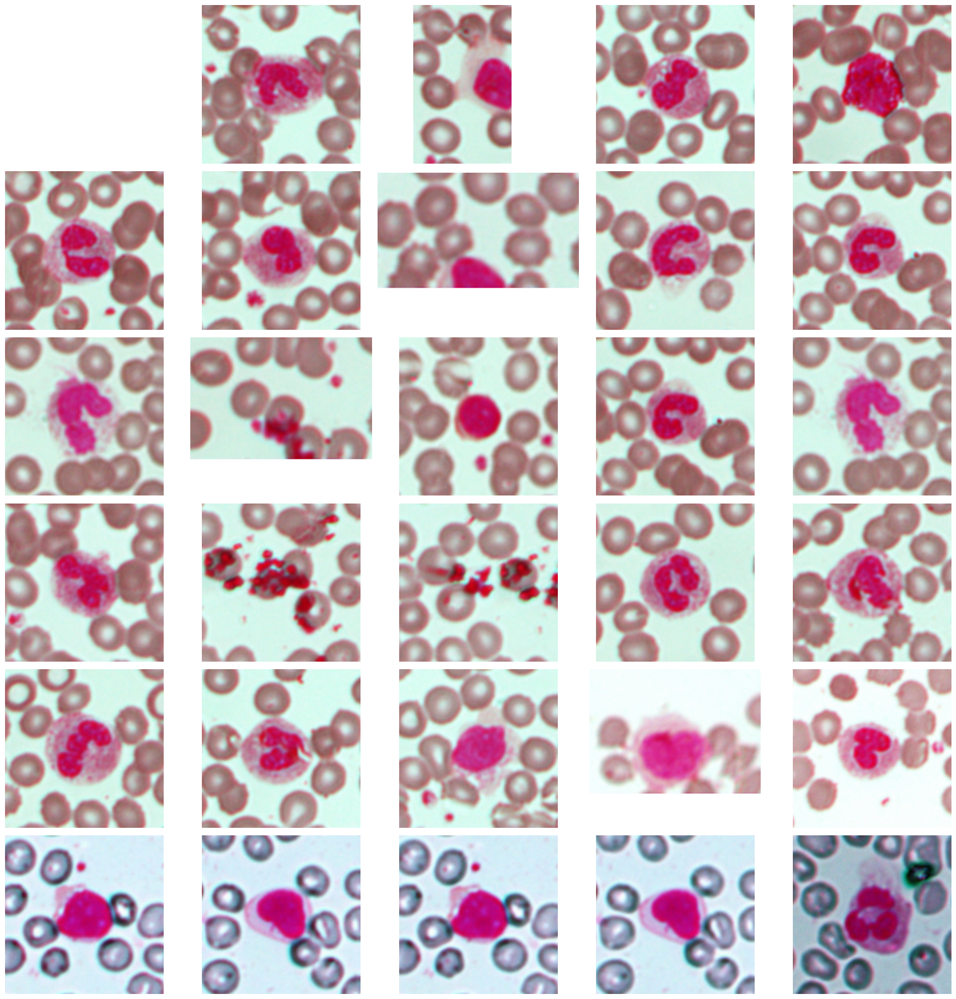

In [2]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import math
import csv
import pandas as pd

image_folder_path = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample'

file_path = []

plt.figure(figsize=(20, 20))

final_image = []
wbc_count_per_image = []
for file_name in os.listdir(image_folder_path):
    if file_name.endswith('.jpg') or file_name.endswith('.jpeg') or file_name.endswith('.png'):
        image_file_path = os.path.join(image_folder_path, file_name)

        img= cv2.imread(image_file_path)
        # Pad the image
        pad = 30
        padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)),
                            mode='constant', constant_values=255)
        # converting BGR into LAB colorspace
        lab = cv2.cvtColor(padded_img, cv2.COLOR_BGR2LAB)
        cv2.imwrite("lab_img.jpg", lab)
        lab = cv2.imread("lab_img.jpg")
        # Convert the image from RGB to HSV
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)
        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])
        # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
        # Finding contours in the image mask
        contours, hierarchy = cv2.findContours(
            img_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        wbc_count = 0
        for cnt in contours:

            x, y, w, h = cv2.boundingRect(cnt)
            if w > 20 and h > 20:
                wbc_count += 1
                # Compute the center of the bounding box
                center_x = x + w // 2
                center_y = y + h // 2
                # Define the size of the cropped image
                crop_size = 150
                # Compute the coordinates of the top-left corner of the cropped image
                crop_x = center_x - crop_size // 2
                crop_y = center_y - crop_size // 2
                # Crop the small image from the original image
                cropped_img = padded_img[crop_y:crop_y +
                                        crop_size, crop_x:crop_x+crop_size]
                # list of cropped images
                final_image.append(cropped_img)
  
        wbc_count_per_image.append([image_file_path, wbc_count])


# save the list to a CSV file
with open("wbc_counts.csv", "w", newline="") as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(["Filename", "WBC Count"])
    writer.writerows(wbc_count_per_image)

# making an output directory
output_folder = "cropped_images8"
os.makedirs(output_folder, exist_ok=True)

# displaying cropped images 
for i in range(len(final_image)):
    if final_image[i] is None or final_image[i].size == 0:
        continue
    resized_image = cv2.resize(final_image[i], (416, 416))
    output_filename = os.path.join(output_folder, f"final_image{i}.jpg")
    cv2.imwrite(output_filename, resized_image)
    plt.subplot(6, 5, i+1)
    plt.imshow(final_image[i], cmap='gray')
    plt.axis('off')
plt.tight_layout()
plt.show()

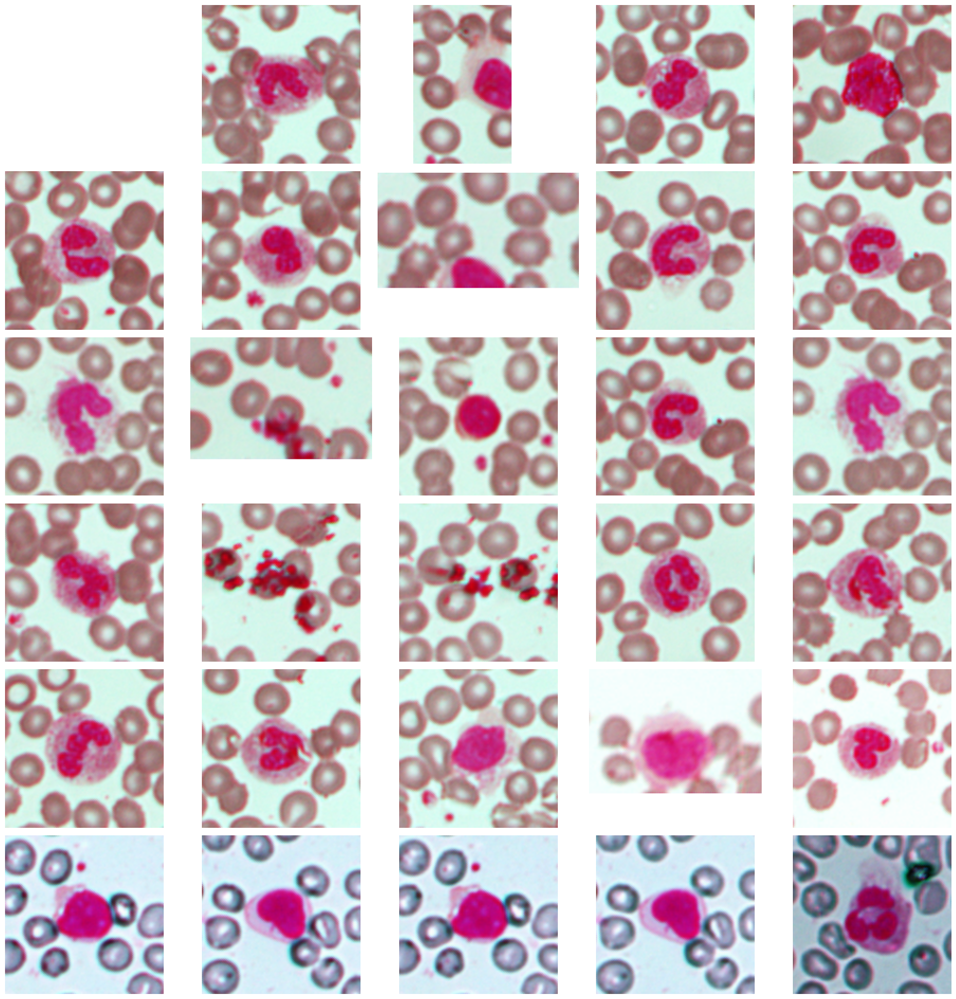

In [3]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import math
import csv
import pandas as pd

image_folder_path = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample'
#os.listdir(image_folder_path)

images = []
file_path = []
for file_name in os.listdir(image_folder_path):
    if file_name.endswith('.jpg') or file_name.endswith('.jpeg') or file_name.endswith('.png'):
        image_file_path = os.path.join(image_folder_path, file_name)
        file_path.append(image_file_path)
        images.append(cv2.imread(image_file_path))

plt.figure(figsize=(20, 20))
# Perform some operations on each image
processed_img_list = []
final_image = []
wbc_count_per_image = []
bb_coordinates = []
for i, img in enumerate(images):

    # Pad the image
    pad = 30
    padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)),
                        mode='constant', constant_values=255)
    # converting BGR into LAB colorspace
    lab = cv2.cvtColor(padded_img, cv2.COLOR_BGR2LAB)

    cv2.imwrite("lab_img.jpg", lab)
    lab = cv2.imread("lab_img.jpg")
    # converting BGR to RGB
    lab = cv2.cvtColor(lab, cv2.COLOR_BGR2RGB)
    # plt.imshow(lab)
    # Convert the image from RGB to HSV
    img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

    # Define the lower and upper bounds for the green color in the HSV color space
    lower_green = np.array([40, 130, 170])
    upper_green = np.array([90, 255, 255])

    # Threshold the HSV image based on the color range
    img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

    # Display the selected image
    # plt.imshow(img_mask,cmap='gray')
    # Finding contours in the image mask
    contours, hierarchy = cv2.findContours(
        img_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    img_res = padded_img.copy()
    wbc_count = 0
    for cnt in contours:

        x, y, w, h = cv2.boundingRect(cnt)
        if w > 20 and h > 20:
            wbc_count += 1
            # Filter out small contours
            # cv2.rectangle(img_copy,(x,y),(x+w,y+h),(0,255,0),2)
            # Compute the center of the bounding box
            center_x = x + w // 2
            center_y = y + h // 2
            # Define the size of the cropped image
            crop_size = 150
            # Compute the coordinates of the top-left corner of the cropped image
            crop_x = center_x - crop_size // 2
            crop_y = center_y - crop_size // 2
            # Crop the small image from the original image
            cropped_img = padded_img[crop_y:crop_y +
                                     crop_size, crop_x:crop_x+crop_size]

            #cv2.rectangle(img_res, (crop_x, crop_y),
            #             (crop_x+crop_size, crop_y+crop_size), (0, 0, 255), 2)
            final_image.append(cropped_img)
            #cv2.putText(img_res, 'WBC', (crop_x, crop_y-10),
            #            cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 0, 255), 5)
            # final_image.append(cropped_img)
            # Draw a green rectangle
            # cv2.putText(img_copy, 'WBC', (x,y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)
            '''plt.subplot(2,len(images),i+1);plt.imshow(img_copy)'''
    wbc_count_per_image.append([file_path[i], wbc_count])
    # Add the processed image to the processed image list
    processed_img_list.append(img_res)

# save the list to a CSV file
with open("wbc_counts.csv", "w", newline="") as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(["Filename", "WBC Count"])
    writer.writerows(wbc_count_per_image)

output_folder = "cropped_images8"
os.makedirs(output_folder, exist_ok=True)

for i in range(len(final_image)):
    if final_image[i] is None or final_image[i].size == 0:
        continue
    resized_image = cv2.resize(final_image[i], (416, 416))
    output_filename = os.path.join(output_folder, f"final_image{i}.jpg")
    cv2.imwrite(output_filename, resized_image)
    plt.subplot(6, 5, i+1)
    plt.imshow(final_image[i], cmap='gray')
    plt.axis('off')
plt.tight_layout()
plt.show()

Postprocessing step to detect the cytoplasm and nucleus of WBC

In [4]:
# defining function for selecting center contours
def select_center_contour(contours):
    if len(contours) == 0:
        return None

    # Compute the areas of all contours
    contour_areas = [cv2.contourArea(contour) for contour in contours]

    # Find the index of the contour with the largest area
    max_area_index = np.argmax(contour_areas)

    # Return the contour with the largest area
    center_contour = contours[max_area_index]

    return center_contour

# defining function for bgr 2 cmyk
def bgr_to_cmyk(bgr):
    b, g, r = bgr/255.0
    b, g, r = b/255.0, g/255.0, r/255.0
    k = 1 - np.max([b, g, r])
    if k == 1:
        c = m = y = 0
    else:
        c = (1 - r - k) / (1 - k)
        m = (1 - g - k) / (1 - k)
        y = (1 - b - k) / (1 - k)
    return np.array([c, m, y, k])
def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour

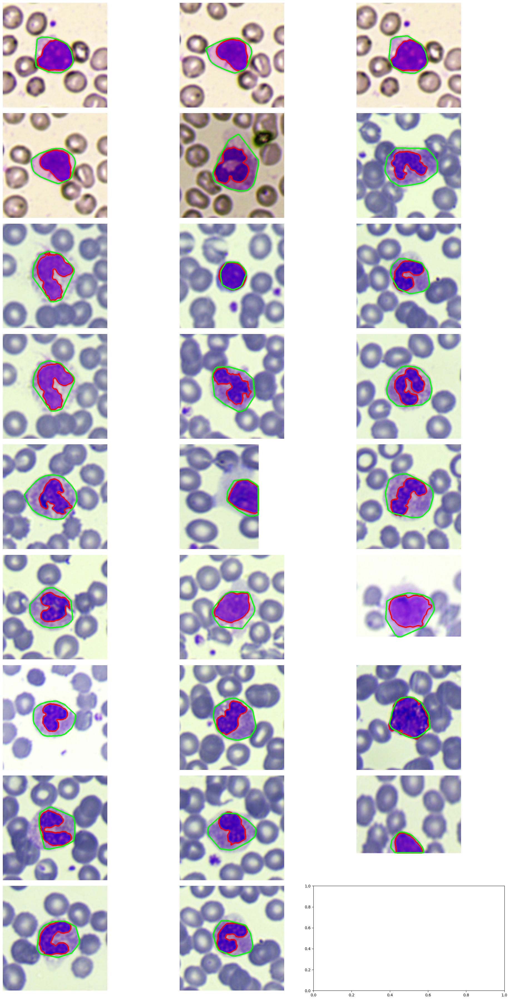

In [5]:

input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\red_images_sample"

processed_image_red = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

        # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()
        # Define the RGB to CMYK conversion function
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        cmyk_img = np.apply_along_axis(
            lambda x: bgr_to_cmyk(x), axis=2, arr=image)
        cmyk_img_copy = cmyk_img.copy()
        # plt.imshow(cmyk_img)
        # Scale the values in the CMYK image to the range 0-255
        cmyk_img = (cmyk_img*255).astype(np.uint8)

        pixels = cmyk_img.reshape(-1, 4)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

        # Perform K-means clustering
        k = 5  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(cmyk_img.shape)

        cv2.imwrite("segmented_image.jpg", segmented_image)
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        bgr_img = cv2.imread("segmented_image.jpg")

        # Convert the bgr image to HSV
        segmented_HSV = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
        # convert to gray scale image
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_BGR2GRAY)
        # Set the threshold value (adjust as needed)

        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
        # Invert the binary image using bitwise_not()
        inverted_image = cv2.bitwise_not(segmented_mask)
        contours, _ = cv2.findContours(
            inverted_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        cv2.drawContours(image_copy, [contours], -1, (0, 0, 255), 3)


        H, S, V = cv2.split(segmented_HSV)

        # Apply thresholding to the H  Channel
        kernel = np.ones((3, 3), np.uint8)
        _, thresholded_image = cv2.threshold(H, 30, 255, cv2.THRESH_BINARY)

        # Define the kernel for erosion and dilation
        kernel = np.ones((5, 5), np.uint8)
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        segmented_mask = cv2.erode(thresholded_image, kernel, iterations=2)
        segmented_mask = cv2.morphologyEx(
            segmented_mask, cv2.MORPH_OPEN, kernel, iterations=1)
        # finding contours of the segmented_mask image
        contours, _ = cv2.findContours(segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        contour_areas = [cv2.contourArea(contour) for contour in contours]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        # Choose the index of the contour you want to smoothen
        # Set the epsilon value for contour smoothing (adjust as needed)
        epsilon = 0.009 * cv2.arcLength(contours[max_area_index], True)
        contours = smooth_contour(contours, epsilon)
        contours = cv2.convexHull(contours)
        cv2.drawContours(image_copy, [contours], -1, (0, 255, 0), 3)
        processed_image_red.append(image_copy)


#-----------------------------------------------------------    For blue images  ---------------------------------------------

input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\blue_images_sample"

processed_image_blue = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

       # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

        # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


        nucleus_contour = select_center_contour(contours)
        cv2.drawContours(image_copy, [nucleus_contour], -1, (0, 0, 255), 3)

        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)


        mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
        segmented_copy = segmented_result.copy()
        # contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        segmented_HSV = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
        H, S, V = cv2.split(segmented_HSV)
        kernel = np.ones((10, 10), np.uint8)
        _, thresholded_image = cv2.threshold(H, 128, 255, cv2.THRESH_BINARY)
        # Perform morphological closing to fill holes
        filled_image = cv2.morphologyEx(
            thresholded_image, cv2.MORPH_CLOSE, kernel)
        kernel = np.ones((10, 10), np.uint8)
        # Perform morphological opening to remove small dust particles
        opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
        contours_cyto, _ = cv2.findContours(
            opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Select the center contour

        contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]

        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)

        convex_cyto = cv2.convexHull(contours_cyto[max_area_index])
        processed_image_blue.append(image_copy)
        cv2.drawContours(image_copy, [convex_cyto], -1, (0, 255, 0), 3)
processed_image = processed_image_red + processed_image_blue
# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(20, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

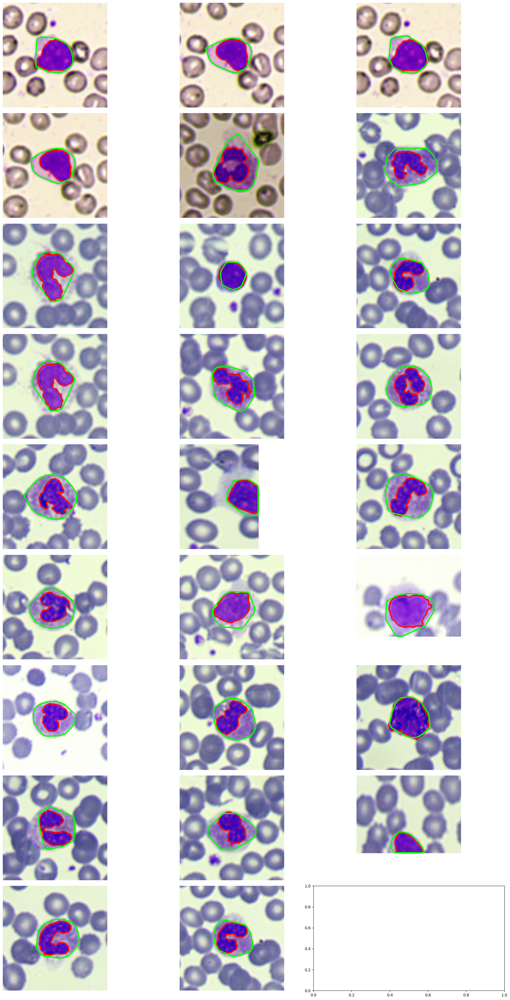

In [6]:

input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\red_images_sample"

processed_image_red = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

        # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()
        # Define the RGB to CMYK conversion function

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour

        def bgr_to_cmyk(bgr):
            b, g, r = bgr/255.0
            b, g, r = b/255.0, g/255.0, r/255.0
            k = 1 - np.max([b, g, r])
            if k == 1:
                c = m = y = 0
            else:
                c = (1 - r - k) / (1 - k)
                m = (1 - g - k) / (1 - k)
                y = (1 - b - k) / (1 - k)
            return np.array([c, m, y, k])

        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        cmyk_img = np.apply_along_axis(
            lambda x: bgr_to_cmyk(x), axis=2, arr=image)
        cmyk_img_copy = cmyk_img.copy()
        # plt.imshow(cmyk_img)
        # Scale the values in the CMYK image to the range 0-255
        cmyk_img = (cmyk_img*255).astype(np.uint8)

        pixels = cmyk_img.reshape(-1, 4)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.9)

        # Perform K-means clustering
        k = 5  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(cmyk_img.shape)

        cv2.imwrite("segmented_image.jpg", segmented_image)
        # Apply the RGB to CMYK conversion to each pixel using a lambda function
        bgr_img = cv2.imread("segmented_image.jpg")

        # Convert the bgr image to HSV
        segmented_HSV = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2HSV)
        # convert to gray scale image
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_BGR2GRAY)
        # Set the threshold value (adjust as needed)

        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
        # Invert the binary image using bitwise_not()
        inverted_image = cv2.bitwise_not(segmented_mask)
        contours, _ = cv2.findContours(
            inverted_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        cv2.drawContours(image_copy, [contours], -1, (0, 0, 255), 3)

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour
        H, S, V = cv2.split(segmented_HSV)

        # Apply thresholding to the H  Channel
        kernel = np.ones((3, 3), np.uint8)
        _, thresholded_image = cv2.threshold(H, 30, 255, cv2.THRESH_BINARY)

        # Define the kernel for erosion and dilation
        kernel = np.ones((5, 5), np.uint8)
        # cv2.drawContours(image_copy, contours, -1, (0, 255, 0), 2)
        segmented_mask = cv2.erode(thresholded_image, kernel, iterations=2)
        segmented_mask = cv2.morphologyEx(
            segmented_mask, cv2.MORPH_OPEN, kernel, iterations=1)

        contours, _ = cv2.findContours(
            segmented_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = select_center_contour(contours)
        contour_areas = [cv2.contourArea(contour) for contour in contours]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        # Choose the index of the contour you want to smoothen

        # Set the epsilon value for contour smoothing (adjust as needed)
        epsilon = 0.009 * cv2.arcLength(contours[max_area_index], True)
        contours = smooth_contour(contours, epsilon)
        contours = cv2.convexHull(contours)
        cv2.drawContours(image_copy, [contours], -1, (0, 255, 0), 3)

        area = contour_areas[max_area_index]
        # peri = contour_perimeter[max_peri_index]
        Cyto_area.append(area)
        # Cyto_Perimeter.append(peri)
        processed_image_red.append(image_copy)

'''# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image_red) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(12, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image_red):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()
'''
#-----------------------------------------------------------    For blue images  ---------------------------------------------

input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\blue_images_sample"

processed_image_blue = []
Cyto_area = []
Cyto_Perimeter = []
# Iterate over the images in the folder
for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
        image_path = os.path.join(input_path, filename)

       # Read the image
        image = cv2.imread(image_path)
        image_copy = image.copy()

        # plt.imshow(blurM)

        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        # Define the lower and upper bounds for the green color in the HSV color space
        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

        # Threshold the HSV image based on the color range
        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

        # Find contours in the thresholded image
        contours, _ = cv2.findContours(
            img_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        def select_center_contour(contours):
            if len(contours) == 0:
                return None

            # Compute the areas of all contours
            contour_areas = [cv2.contourArea(contour) for contour in contours]

            # Find the index of the contour with the largest area
            max_area_index = np.argmax(contour_areas)

            # Return the contour with the largest area
            center_contour = contours[max_area_index]

            return center_contour
        nucleus_contour = select_center_contour(contours)
        cv2.drawContours(image_copy, [nucleus_contour], -1, (0, 0, 255), 3)

        pixels = image.reshape(-1, 3)
        pixels = np.float32(pixels)
        # Define the criteria for K-means clustering (maximum iterations and epsilon)
        criteria = (cv2.TERM_CRITERIA_EPS +
                    cv2.TERM_CRITERIA_MAX_ITER, 100, 0.5)

        # Perform K-means clustering
        k = 7  # Number of clusters
        _, labels, centers = cv2.kmeans(
            pixels, k, None, criteria, 100, cv2.KMEANS_RANDOM_CENTERS)

        # Convert the centers to unsigned integers
        centers = np.uint8(centers)
        # Map the labels to the centers
        segmented_image = centers[labels.flatten()]

        # Reshape the segmented image back to the original shape
        segmented_image = segmented_image.reshape(image.shape)

        # Convert the segmented image to grayscale
        segmented_image_gray = cv2.cvtColor(
            segmented_image, cv2.COLOR_RGB2GRAY)

        # Threshold the grayscale image
        _, segmented_mask = cv2.threshold(
            segmented_image_gray, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)

        # Apply the segmented mask to the original image
        segmented_result = cv2.bitwise_and(
            image_copy, image_copy, mask=segmented_mask)

        def smooth_contour(contour, epsilon):
            # Convert the contour to a numpy array
            contour = np.squeeze(contour)

            # Reshape the contour to fit the required format for cv2.approxPolyDP
            contour = contour.reshape((-1, 1, 2))

            # Apply the Douglas-Peucker algorithm for contour approximation
            smoothed_contour = cv2.approxPolyDP(contour, epsilon, True)

            return smoothed_contour
        #mask = np.zeros(segmented_mask.shape[:2], dtype="uint8")
        segmented_copy = segmented_result.copy()
        # contours, _ = cv2.findContours(contour_portion,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        segmented_HSV = cv2.cvtColor(segmented_result, cv2.COLOR_BGR2HSV)
        H, S, V = cv2.split(segmented_HSV)
        kernel = np.ones((10, 10), np.uint8)
        _, thresholded_image = cv2.threshold(H, 128, 255, cv2.THRESH_BINARY)
        # Perform morphological closing to fill holes
        filled_image = cv2.morphologyEx(
            thresholded_image, cv2.MORPH_CLOSE, kernel)
        kernel = np.ones((10, 10), np.uint8)
        # Perform morphological opening to remove small dust particles
        opened_image = cv2.morphologyEx(filled_image, cv2.MORPH_OPEN, kernel)
        contours_cyto, _ = cv2.findContours(
            opened_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        # Select the center contour

        contour_areas = [cv2.contourArea(contour) for contour in contours_cyto]
        contour_perimeter = [cv2.arcLength(
            contour, True) for contour in contours_cyto]
        # Find the index of the contour with the largest area
        max_area_index = np.argmax(contour_areas)
        max_peri_index = np.argmax(contour_perimeter)
        area = contour_areas[max_area_index]
        peri = contour_perimeter[max_peri_index]
        convex_cyto = cv2.convexHull(contours_cyto[max_area_index])
        Cyto_area.append(area)
        Cyto_Perimeter.append(peri)
        processed_image_blue.append(image_copy)
        cv2.drawContours(image_copy, [convex_cyto], -1, (0, 255, 0), 3)
processed_image = processed_image_red + processed_image_blue
# Create a grid for displaying the images
grid_rows = int(np.ceil(len(processed_image) / 3))
fig, axes = plt.subplots(grid_rows, 3, figsize=(20, 4 * grid_rows))

# Iterate over the processed images and display them in the grid
for i, image_x in enumerate(processed_image):
    row = i // 3
    col = i % 3
    axes[row, col].imshow(cv2.cvtColor(image_x, cv2.COLOR_BGR2RGB))
    axes[row, col].axis('off')

# Adjust the layout and display the grid
plt.tight_layout()
plt.show()

Differential WBC using Yolov5x

In [ ]:
%cd C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\yolov5
!python detect.py --weights C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\weights_100epochs\best.pt --img 416 --conf 0.4 --data C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\yolov5\data\data.yaml --source C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\cropped_images8

In [ ]:
import glob
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(12, 12))

for i, imageName in enumerate(glob.glob('C:/Users/User/Downloads/Dewinter2023/Final_yolov5x/yolov5/runs/detect/exp52/*.jpg')):
    row = i // 5
    col = i % 5
    ax = axes[row, col]
    img = Image.open(imageName)
    img_array = np.array(img)
    ax.imshow(img_array)
    ax.axis('off')

plt.show()

In [ ]:
pred = pd.read_csv("C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\yolov5\\predictions.csv")
N = len(pred[pred["Predicted Class"]=="neutrophil"])
E = len(pred[pred["Predicted Class"]=="eosinophil"])
L = len(pred[pred["Predicted Class"]=="lymphocyte"])
M = len(pred[pred["Predicted Class"]=="monocyte"])
B = len(pred[pred["Predicted Class"]=="basophil"])
T = N+E+L+M+B
N_1=N*100/T
E_1=E*100/T
L_1=L*100/T
M_1=M*100/T
B_1=B*100/T
print("DIFFERENTIAL BLOOD COUNT\n\nPercentage Neutrophil",N_1," \nPercentage Lymphocyte",L_1," \nPercentage Monocyte",M_1," \nPercentage Eosinophil",E_1,"\nPercentage Basophil",B_1)



Differential WBC through feature extraction of cell and nucleus

In [ ]:
import pandas as pd
df = pd.read_csv("C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\csv_results\\final.csv", index_col =0)
df = df.rename(columns={"IMAGE_NAME":"Image_Name","NUCLEUS_AREA":"Nucleus_Area","NUCLEUS_PERIMETER":"Nucleus_Perimeter","CYTO_AREA":"Cyto_Area","CYTO_PERIMETER":"Cyto_Perimeter"})
df.head()

RBC DETECTION FOR RED SAMPLE 

Red sample Blood Report :
Total rbc: 303.5
haemoglobin perecentage :Red pigment in the image  34.38622160627715
MCV : 403337.64997923205
RDW: 8.51973758499104
Total WBC : 0
Total Platelets : 0
Normal RBC : 0
percentage normal : 0.0

BLUE SAMPLE BLOOD REPORT :
Total rbc: 243.5
haemoglobin perecentage : 87.70093630391244
MCV : 202083.58300301374
RDW: 12.942365933727798
Normal RBC : 0
percentage normal : 0.0
Total WBC : 0
Total Platelets : 0


<Figure size 1000x1000 with 0 Axes>

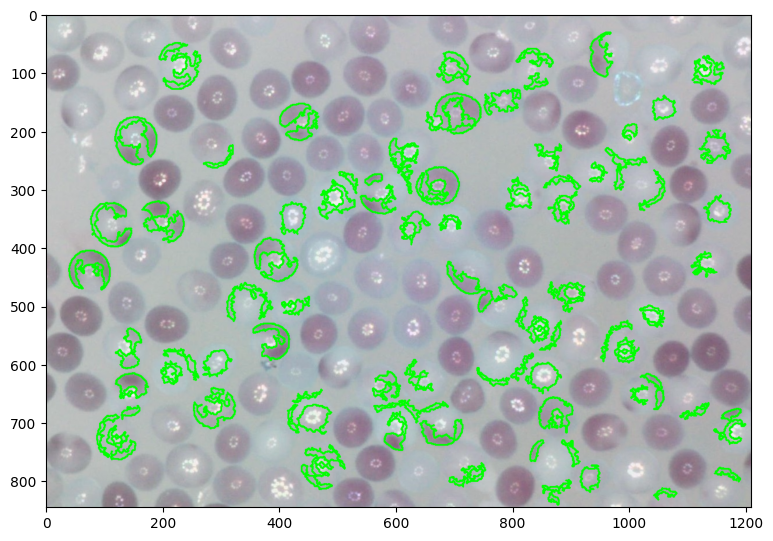

<Figure size 2000x2000 with 0 Axes>

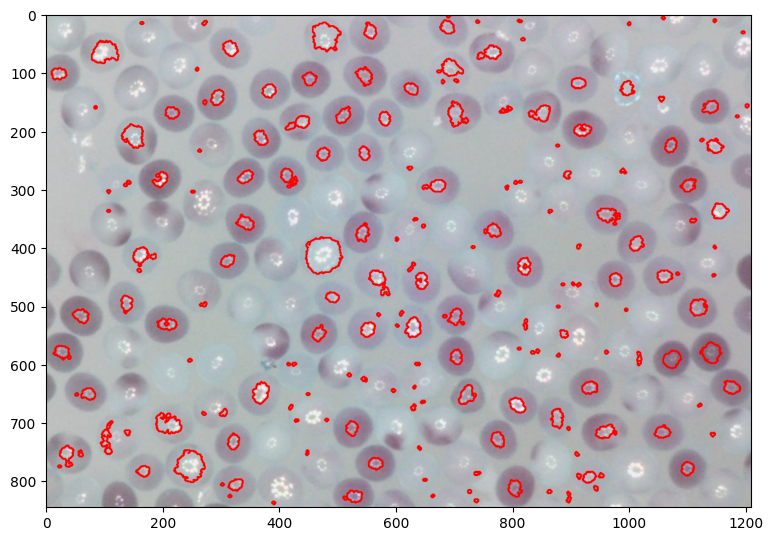

In [9]:
#importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
bgr=  cv2.imread(input_path)
bgr_gray=  cv2.imread(input_path,0)
bgr_copy_2 = bgr.copy()
lab = cv2.cvtColor(bgr, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

#split into channels
b,g,r = cv2.split(bgr)
#apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(bgr_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 21, 2)
# Fill holes
filled_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)))
img_mask= cv2.dilate(img_mask,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4, 4)),iterations=2)
# subtracting the wbc and platelets mask from the original image
filled_image =(filled_image)-img_mask
# External contours of rbc
contours_ext,hierarchy = cv2.findContours(filled_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contour_data_list_1 =[]

# empty dictionary for rbc,wbc, platelets count
Count_1={"RBC":0,"Platelet":0,"WBC":0}

contours_new = []

# Get the dimensions of the image
image_height, image_width = bgr.shape[:2]

# Create a list to store the non-boundary contours
non_boundary_contours = []

# Iterate through all the contours
for contour in contours_ext:
    min_contour_area = 250  # Minimum threshold area for rbc
    max_contour_area = 2000
    # Flag to check if contour touches the boundaries
    is_boundary = False
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
   
    # Calculate the contour area
    area = cv2.contourArea(approx)
    x, y, w, h = cv2.boundingRect(approx)
    # Iterate through all the points in the contour
    for point in contour:

        # Check if any point is touching the boundaries of the image
        x, y = point[0]       
        if x == 0 or x == image_width - 1 or y == 0 or y == image_height - 1:
              is_boundary=True 
              break 
    # Break the inner loop if any point touches the boundary
    if area >= min_contour_area and area < max_contour_area:
   # If the contour is not touching the boundary, add it to the non-boundary contours list
        if not is_boundary:
           cv2.drawContours(bgr_copy_2,[contour],-1,(0,255,0),2)
 

for contour in contours_ext:
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
    min_contour_area = 250  # Minimum threshold area for rbc
    max_contour_area = 2000
    # Calculate the contour area
    area = cv2.contourArea(approx)
    x, y, w, h = cv2.boundingRect(approx)

    if area >= min_contour_area and area < max_contour_area:
        M = cv2.moments(approx)
        center_x = int(M["m10"] / M["m00"])
        center_y = int(M["m01"] / M["m00"])
        Count_1["RBC"] += 1
        # Add the contour number as text
        contour_number = str(Count_1["RBC"])
        contours_new.append(approx)
        # Add the contour data to the DataFrame
        # Inside the loop, create a dictionary of the contour data
        contour_dict = {"Contour Number": contour_number,
                "Contour": approx,
                "Area": area,
                "Perimeter": cv2.arcLength(approx, True)}
        contour_data_list_1.append(contour_dict)
        # Create a DataFrame from the list of dictionaries
        contour_data_1 = pd.DataFrame(contour_data_list_1)
        #cv2.drawContours(bgr_copy_1, [contour], -1, (255, 0, 0), 2)
rbc_count =Count_1["RBC"]
Count_1["RBC"]=0
outer_rbc_area = np.sum([cv2.contourArea(contour) for contour in contours_new])
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >15:
            
            if contour_hierarchy[3] != -1:
                Count_1["RBC"]+=1
                # Inner contour (Has parent contour)
                inner_rbc_area += area
                
                #cv2.drawContours(bgr_copy_2,[contour],-1,(255,0,0),2)
total_rbc = (Count_1["RBC"]+rbc_count)/2
print("Red sample Blood Report :")
print("Total rbc:",total_rbc)

print("haemoglobin perecentage :Red pigment in the image ",(outer_rbc_area-inner_rbc_area)*100 /outer_rbc_area )

# calculating the MCV of RBCs
"""MCV stands for Mean Corpuscular Volume, and it is a measure of the average volume or size of red blood cells (erythrocytes) in a blood sample.
 It is typically reported in units of femtoliters (fL)."""
def calculate_mcv(contours):
    total_diameter = 0
    num_rbc = 0
    
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > 250:  # Filter out small contours
            num_rbc += 1
            (x, y), (w, h), _ = cv2.fitEllipse(contour)
            diameter = max(w, h)
            total_diameter += diameter
    
    mean_diameter = total_diameter / num_rbc
    mcv = (np.pi / 6) * (mean_diameter**3)
    return mcv

MCV = calculate_mcv(contours_new)
print("MCV :",MCV)

# Function to calculate coarseness
def calculate_coarseness(contour):
    perimeter = cv2.arcLength(contour, True)
    coarseness = perimeter / (2 * np.pi)
    return coarseness

# Function to calculate circularity
def calculate_circularity(contour):
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    circularity = 4 * np.pi * (area / (perimeter * perimeter))
    return circularity

# calculating RDW of rbcs
"""variation in size of red blood cells (erythrocytes) in a blood sample. The RDW value is typically reported as a percentage.
lower rdw less variation in size"""
def calculate_rdw(contours):
    rbc_volumes = []

    for contour in contours:
        contour= cv2.convexHull(contour)
        area = cv2.contourArea(contour)
        radius = np.sqrt(area / np.pi)
        volume = (4/3) * np.pi * radius**3
        rbc_volumes.append(volume)

    mean_cell_volume = np.mean(rbc_volumes)
    rdw = np.std(rbc_volumes) / mean_cell_volume *10
    return rdw
rdw = calculate_rdw(contours_new)
print("RDW:", rdw)

# Finding count  of  WBC and platelets
contours_platelets,_ = cv2.findContours(img_mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
min_contour_area =800
for contour in contours_platelets:
    area = cv2.contourArea(contour)
    if area <min_contour_area:
       #cv2.drawContours(bgr_copy_1,[contour],-1,(0,255,0),2)
       Count_1["Platelet"]=Count_1["Platelet"]+1
    else:
        #cv2.drawContours(bgr_copy_1,[contour],-1,(0,0,255),2)
        Count_1["WBC"]=Count_1["WBC"]+1
plt.figure(figsize=(10,10))
#plt.imshow(bgr_copy_1)
print("Total WBC :",Count_1["WBC"])
print("Total Platelets :",Count_1["Platelet"])


contour_data_1["Coarseness"] = contour_data_1["Contour"].apply(calculate_coarseness)
# Calculate additional features for each contour
contour_data_1["Circularity"] = contour_data_1["Contour"].apply(calculate_circularity)
contour_data=contour_data_1.copy()
#Choosing Normal RBC which are circular in shape and have normal size variation
filtered_normal_contours = contour_data[(contour_data["Coarseness"]>14) & (contour_data["Coarseness"]<21)&(contour_data["Circularity"]>0.80)]
print("Normal RBC :",len(filtered_normal_contours))
print("percentage normal :",len(filtered_normal_contours)*100/total_rbc)
normal = filtered_normal_contours["Contour"].values
plt.figure(figsize=(20,20))
plt.subplot(121);plt.imshow(bgr_copy_2)

'''------------------------------------------------BLUE SAMPLE--------------------------------------------------------------------------'''


plt.figure(figsize=(20,20))
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
bgr=  cv2.imread(input_path)
bgr_gray=cv2.imread(input_path,0)
crop = bgr
bgr_copy_1=bgr.copy()
b,g,r = cv2.split(crop)
# Perform histogram equalization on the green channel
g_equalized = cv2.equalizeHist(g)

# Perform contrast stretching
min_intensity = 100
max_intensity = 255
stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)

# Apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 31, 2)


# Fill holes
lab = cv2.cvtColor(crop, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
img_mask_new = cv2.dilate(img_mask,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=2)
#filled_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)))
filled_image = cv2.erode(binary_image,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=1)
filled_image_new = filled_image-img_mask_new


# External contours of rbc
contours_ext,hierarchy = cv2.findContours(filled_image_new, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contour_data_list_2 = []

# empty dictionary for rbc,wbc, platelets count
Count_1={"RBC":0,"Platelet":0,"WBC":0}
min_contour_area = 50
max_contour_area = 5000
contours_new = []
# Get the dimensions of the image
image_height, image_width = bgr.shape[:2]

# Create a list to store the non-boundary contours
non_boundary_contours = []

# Iterate through all the contours
for contour in contours_ext:
    # Flag to check if contour touches the boundaries
    is_boundary = False
        # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
   
    # Calculate the contour area
    area = cv2.contourArea(approx)
    x, y, w, h = cv2.boundingRect(approx)

    # Iterate through all the points in the contour
    for point in contour:
        # Check if any point is touching the boundaries of the image
        x, y = point[0]
        
        if x == 0 or x == image_width - 1 or y == 0 or y == image_height - 1:
              is_boundary = True
              break  # Break the inner loop if any point touches the boundary
        '''if area >min_contour_area and area < max_contour_area:
            cv2.drawContours(bgr_copy_1,[contour],-1,(0,255,0),2)'''
    # If the contour is not touching the boundary, add it to the non-boundary contours list
    if area > min_contour_area and area < max_contour_area:
       if not is_boundary:
          cv2.drawContours(bgr_copy_1,[contour],-1,(0,255,0),2)
          non_boundary_contours.append(contour)

for contour in contours_ext:
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
   
    # Calculate the contour area
    area = cv2.contourArea(approx)
    x, y, w, h = cv2.boundingRect(approx)

    if area >= min_contour_area and area < max_contour_area:
        M = cv2.moments(approx)
        center_x = int(M["m10"] / M["m00"])
        center_y = int(M["m01"] / M["m00"])
        Count_1["RBC"] += 1
        # Add the contour number as text
        contour_number = str(Count_1["RBC"])
        contours_new.append(approx)
        text_size, _ = cv2.getTextSize(contour_number, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
        text_width, text_height = text_size
        text_x = center_x - int(text_width / 2)
        text_y = center_y + int(text_height / 2)
        #cv2.putText(bgr_copy_1, contour_number, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
        # Add the contour data to the DataFrame
        contour_data_list_2.append({"Contour Number": contour_number,"Contour" : approx,"Area": area, "Perimeter": cv2.arcLength(approx, True)})
        contour_data_2 = pd.DataFrame(contour_data_list_2)
        cv2.drawContours(bgr_copy_1, [contour], -1, (255, 0, 0), 2)
rbc_count =Count_1["RBC"]
Count_1["RBC"]=0
outer_rbc_area = np.sum([cv2.contourArea(contour) for contour in contours_new])
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image_new, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >15:
            
            if contour_hierarchy[3] != -1:
                Count_1["RBC"]+=1
                # Inner contour (Has parent contour)
                inner_rbc_area += area
                
                cv2.drawContours(bgr_copy_1,[contour],-1,(255,0,0),2)
total_rbc = (Count_1["RBC"]+rbc_count)/2
print("\nBLUE SAMPLE BLOOD REPORT :")
print("Total rbc:",total_rbc)
print("haemoglobin perecentage :",((outer_rbc_area-inner_rbc_area))*100 /outer_rbc_area )


MCV = calculate_mcv(contours_new)
print("MCV :",MCV)

rdw = calculate_rdw(contours_new)
print("RDW:", rdw)


contour_data_2["Coarseness"] = contour_data_2["Contour"].apply(calculate_coarseness)
# Calculate additional features for each contour
contour_data_2["Circularity"] = contour_data_2["Contour"].apply(calculate_circularity)
contour_data=contour_data_2.copy()
#Choosing Normal RBC which are circular in shape and have normal size variation
filtered_normal_contours = contour_data[(contour_data["Coarseness"]>14) & (contour_data["Coarseness"]<21)&(contour_data["Circularity"]>0.80)]
print("Normal RBC :",len(filtered_normal_contours))
print("percentage normal :",len(filtered_normal_contours)*100/total_rbc)
normal = filtered_normal_contours["Contour"].values
# Display the mask image with only circular contours
min_contour_area = 30
max_contour_area = 5000

#cv2.drawContours(crop_copy, contours_red, -1, (255, 0, 0), 2)
contours_platelets,_ = cv2.findContours(img_mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
min_contour_area =1000
for contour in contours_platelets:
    area = cv2.contourArea(contour)
    if area >min_contour_area:
        #cv2.drawContours(crop_copy,[contour],-1,(0,0,255),2)
        Count_1["WBC"]=Count_1["WBC"]+1
    else:
        #cv2.drawContours(crop_copy,[contour],-1,(0,255,0),2)
        Count_1["Platelet"]=Count_1["Platelet"]+1
  
print("Total WBC :",Count_1["WBC"])
print("Total Platelets :",Count_1["Platelet"])
plt.figure(figsize=(20,20))
plt.subplot(122);cv2.imwrite("new_copy.jpg",bgr_);plt.imshow(bgr_copy_1)




error: OpenCV(4.7.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\thresh.cpp:1675: error: (-215:Assertion failed) blockSize % 2 == 1 && blockSize > 1 in function 'cv::adaptiveThreshold'


In [3]:
import sys
from PyQt5.QtWidgets import QApplication, QMainWindow, QLabel, QSlider
from PyQt5.QtCore import Qt
import cv2
import matplotlib.pyplot as plt

class MainWindow(QMainWindow):
    def __init__(self):
        super().__init__()
        self.setWindowTitle("Image Processing")
        self.setGeometry(100, 100, 800, 600)
        
        self.image_label = QLabel(self)
        self.image_label.setGeometry(10, 10, 780, 500)
        
        self.threshold_slider = QSlider(Qt.Horizontal, self)
        self.threshold_slider.setGeometry(10, 520, 780, 20)
        self.threshold_slider.setMinimum(0)
        self.threshold_slider.setMaximum(255)
        self.threshold_slider.valueChanged.connect(self.update_image)
        
        self.area_slider = QSlider(Qt.Horizontal, self)
        self.area_slider.setGeometry(10, 550, 780, 20)
        self.area_slider.setMinimum(0)
        self.area_slider.setMaximum(1000)
        self.area_slider.valueChanged.connect(self.update_image)
        
        self.bgr_copy = None
        
    def update_image(self):
        threshold = self.threshold_slider.value()
        min_area = self.area_slider.value()
        
        if self.bgr_copy is not None:
            bgr_copy_3 = self.bgr_copy.copy()
            b, g, r = cv2.split(self.bgr_copy)
            g_equalized = cv2.equalizeHist(g)
            min_intensity = 100
            max_intensity = 255
            stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)
            binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, threshold, 2)
            filled_image = cv2.erode(binary_image, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)), iterations=1)
            contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
            inner_rbc_area = 0
            min_contour_area = 30
            for i in range(len(contours)):
                contour = contours[i]
                contour_hierarchy = hierarchy[0][i]
                area = cv2.contourArea(contour)
                if area > min_area and area < 900:
                    if contour_hierarchy[3] != -1:
                        cv2.drawContours(bgr_copy_3, [contour], -1, (255, 0, 0), 2)
            
            self.display_image(bgr_copy_3)
        
    def display_image(self, image):
        qimage = QImage(image.data, image.shape[1], image.shape[0], QImage.Format_RGB888)
        pixmap = QPixmap.fromImage(qimage)
        pixmap = pixmap.scaled(780, 500, Qt.KeepAspectRatio)
        self.image_label.setPixmap(pixmap)
        self.bgr_copy = image.copy()

if __name__ == "__main__":
    app = QApplication(sys.argv)
    window = MainWindow()
    window.show()
    
    # Load the image
    input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
    bgr = cv2.imread(input_path)
    window.display_image(bgr)
    
    sys.exit(app.exec_())


: 

: 

In [2]:
!pip install PyQt5

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
# best results
import cv2
import tkinter as tk
from PIL import Image, ImageTk
from tkinter import ttk
final_contour =[]

def update_image(event=None):
    min_area = area_slider.get()
    threshold = new_slider.get()
    block_size = int(block_slider.get())
    
    if block_size % 2 == 0:
        block_size += 1
    if bgr_copy is not None:
        bgr_copy_3 = bgr_copy.copy()
        
        b, g, r = cv2.split(bgr_copy_3)
        g_equalized = cv2.add(g,cv2.equalizeHist(g))
        min_intensity = 100
        max_intensity = 255
        stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)

        binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, block_size, threshold)
        filled_image = cv2.erode(binary_image, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)), iterations=1)
        contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
        inner_rbc_area = 0
        min_contour_area = 30
        for i in range(len(contours)):
            contour = contours[i]
            contour_hierarchy = hierarchy[0][i]
            area = cv2.contourArea(contour)
            if area > min_area and area < 900:
                if contour_hierarchy[3] != -1:
                    final_contour.append(contour)
                    cv2.drawContours(bgr_copy_3, [contour], -1, (255, 0, 0), 2)
        # ...
        # Display the processed image
        display_image(bgr_copy_3)

def display_image(image):
    img = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    img = img.resize((780, 500))
    img_tk = ImageTk.PhotoImage(img)
    image_label.config(image=img_tk)
    image_label.image = img_tk

# Load the image
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
bgr = cv2.imread(input_path)
bgr_copy = bgr.copy()

# Create the GUI window
window = tk.Tk()
window.title("Image Processing")
window.geometry("800x650")

# Create the image label
image_label = tk.Label(window)
image_label.place(x=10, y=10, width=780, height=500)

# Create the area slider
area_slider = ttk.Scale(window, from_=0, to=1000, orient=tk.HORIZONTAL, length=780)
area_slider.place(x=10, y=520, width=780, height=30)
area_slider.bind("<B1-Motion>", update_image)

# Create the threshold slider
new_slider = ttk.Scale(window, from_=0, to=200, orient=tk.HORIZONTAL, length=780)
new_slider.place(x=10, y=560, width=780, height=30)
new_slider.bind("<B1-Motion>", update_image)

# Create the block size slider
block_slider = ttk.Scale(window, from_=3, to=51, orient=tk.HORIZONTAL, length=780)
block_slider.place(x=10, y=600, width=780, height=30)
block_slider.bind("<B1-Motion>", update_image)

# Set initial slider values
area_slider.set(0)
new_slider.set(0)
block_slider.set(11)

# Display the original image
display_image(bgr_copy)

# Start the GUI event loop
window.mainloop()


print()

True

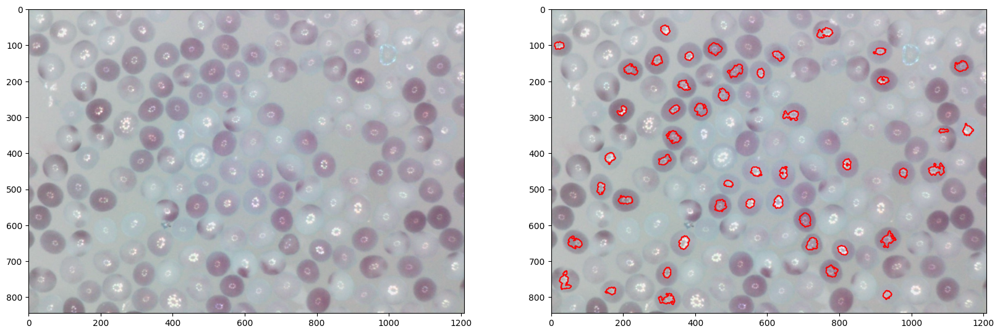

In [33]:
import matplotlib.pyplot as plt
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
bgr=  cv2.imread(input_path)
bgr_gray=cv2.imread(input_path,0)
bgr_copy_3=bgr.copy()
b,g,r = cv2.split(bgr)
# Perform histogram equalization on the green channel
g_equalized = cv2.equalizeHist(g)

# Perform contrast stretching
min_intensity = 100
max_intensity = 255
stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)
x=int(slider_count[-1])
y=threshold_count[-1]
# Apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV,x ,y )
filled_image = cv2.erode(binary_image,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=1)
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >min_areas[-1] and area < 900:     
            if contour_hierarchy[3] != -1:
               cv2.drawContours(bgr_copy_3,[contour],-1,(255,0,0),2)
plt.figure(figsize=(20,20))
plt.subplot(121);plt.imshow(bgr)
plt.subplot(122);plt.imshow(bgr_copy_3)
cv2.imwrite("result_img.jpg",bgr_copy_3)

In [ ]:
import matplotlib.pyplot as plt
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
bgr=  cv2.imread(input_path)
bgr_gray=cv2.imread(input_path,0)
bgr_copy_3=bgr.copy()
b,g,r = cv2.split(bgr)
# Perform histogram equalization on the green channel
g_equalized = cv2.equalizeHist(g)

# Perform contrast stretching
min_intensity = 100
max_intensity = 255
stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)
x=31
y=2
# Apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV,x ,y )
filled_image = cv2.erode(binary_image,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=1)
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >70 and area < 900:     
            if contour_hierarchy[3] != -1:
               cv2.drawContours(bgr_copy_3,[contour],-1,(255,0,0),2)
plt.figure(figsize=(20,20))
plt.subplot(121);plt.imshow(bgr)
plt.subplot(122);plt.imshow(bgr_copy_3)
cv2.imwrite("result_img.jpg",bgr_copy_3)

In [ ]:
'''#include <opencv2/opencv.hpp>
#include <iostream>

using namespace cv;
using namespace std;

int main()
{
    string input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg";
    Mat bgr = imread(input_path);
    Mat bgr_gray = imread(input_path, IMREAD_GRAYSCALE);
    Mat bgr_copy_3 = bgr.clone();
    vector<Mat> bgr_channels;
    split(bgr, bgr_channels);
    Mat g_equalized;
    equalizeHist(bgr_channels[1], g_equalized);

    int min_intensity = 100;
    int max_intensity = 255;
    Mat stretched;
    normalize(g_equalized, stretched, min_intensity, max_intensity, NORM_MINMAX);

    int x = 31;
    int y = 2;
    Mat binary_image;
    adaptiveThreshold(stretched, binary_image, 255, ADAPTIVE_THRESH_MEAN_C, THRESH_BINARY_INV, x, y);

    Mat filled_image;
    Mat kernel = getStructuringElement(MORPH_ELLIPSE, Size(3, 3));
    erode(binary_image, filled_image, kernel, Point(-1, -1), 1);

    vector<vector<Point>> contours;
    vector<Vec4i> hierarchy;
    findContours(filled_image, contours, hierarchy, RETR_CCOMP, CHAIN_APPROX_SIMPLE);

    int min_contour_area = 30;
    for (size_t i = 0; i < contours.size(); i++) {
        vector<Point> contour = contours[i];
        Vec4i contour_hierarchy = hierarchy[i];
        double area = contourArea(contour);
        if (area > 70 && area < 900) {
            if (contour_hierarchy[3] != -1) {
                drawContours(bgr_copy_3, contours, i, Scalar(255, 0, 0), 2);
            }
        }
    }

    imshow("Original Image", bgr);
    imshow("Processed Image", bgr_copy_3);
    imwrite("result_img.jpg", bgr_copy_3);

    waitKey(0);
    destroyAllWindows();

    return 0;
}
'''

In [ ]:
'''#include <opencv2/opencv.hpp>
#include <iostream>

std::vector<cv::Point> final_contour;
std::vector<int> min_areas;
std::vector<int> threshold_count;
std::vector<int> slider_count;
cv::Mat bgr_copy;

void update_image(int, void*)
{
    int min_area = area_slider_value;
    min_areas.push_back(min_area);
    int threshold = threshold_slider_value;
    threshold_count.push_back(threshold);
    int block_size = block_slider_value;

    if (block_size % 2 == 0) {
        block_size += 1;
        slider_count.push_back(block_size);
    }
    
    if (!bgr_copy.empty()) {
        cv::Mat bgr_copy_3 = bgr_copy.clone();

        std::vector<cv::Mat> bgr;
        cv::split(bgr_copy_3, bgr);
        cv::Mat g_equalized;
        cv::equalizeHist(bgr[1], g_equalized);

        int min_intensity = 100;
        int max_intensity = 255;
        cv::Mat stretched;
        cv::normalize(g_equalized, stretched, min_intensity, max_intensity, cv::NORM_MINMAX);

        cv::Mat binary_image;
        cv::adaptiveThreshold(stretched, binary_image, 255, cv::ADAPTIVE_THRESH_MEAN_C, cv::THRESH_BINARY_INV, block_size, threshold);

        cv::Mat filled_image;
        cv::Mat kernel = cv::getStructuringElement(cv::MORPH_ELLIPSE, cv::Size(3, 3));
        cv::erode(binary_image, filled_image, kernel, cv::Point(-1, -1), 1);

        std::vector<std::vector<cv::Point>> contours;
        std::vector<cv::Vec4i> hierarchy;
        cv::findContours(filled_image, contours, hierarchy, cv::RETR_CCOMP, cv::CHAIN_APPROX_SIMPLE);

        int min_contour_area = 30;
        for (size_t i = 0; i < contours.size(); i++) {
            cv::Mat contour = contours[i];
            cv::Vec4i contour_hierarchy = hierarchy[i];
            double area = cv::contourArea(contour);
            if (area > min_area && area < 900) {
                if (contour_hierarchy[3] != -1) {
                    final_contour.push_back(contour[0]);
                    cv::drawContours(bgr_copy_3, contours, i, cv::Scalar(255, 0, 0), 2);
                }
            }
        }

        // Display the processed image
        cv::imshow("Image Processing", bgr_copy_3);
    }
}

int main()
{
    // Load the image
    std::string input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg";
    cv::Mat bgr = cv::imread(input_path);
    bgr_copy = bgr.clone();

    // Create the GUI window
    cv::namedWindow("Image Processing");

    // Create the area slider
    int area_slider_value = 0;
    int area_slider_max = 1000;
    cv::createTrackbar("Area", "Image Processing", &area_slider_value, area_slider_max, update_image);

    // Create the threshold slider
    int threshold_slider_value = 0;
    int threshold_slider_max = 200;
    cv::createTrackbar("Threshold", "Image Processing", &threshold_slider_value, threshold_slider_max, update_image);

    // Create the block size slider
    int block_slider_value = 11;
    int block_slider_max = 51;
    cv::createTrackbar("Block Size", "Image Processing", &block_slider_value, block_slider_max, update_image);

    // Set initial slider values
    update_image(0, nullptr);

    // Start the GUI event loop
    cv::waitKey(0);

    // Print the collected values
    std::cout << "Min Areas: ";
    for (int min_area : min_areas) {
        std::cout << min_area << " ";
    }
    std::cout << std::endl;

    std::cout << "Slider Counts: ";
    for (int slider_count : slider_count) {
        std::cout << slider_count << " ";
    }
    std::cout << std::endl;

    std::cout << "Threshold Counts: ";
    for (int threshold_count : threshold_count) {
        std::cout << threshold_count << " ";
    }
    std::cout << std::endl;

    return 0;
}
'''

In [62]:
for contour in final_contour:
        parent_index = hierarchy_new[0][contours_new.index(contour)][3]
        if parent_index != -1:
                parent_contour = contours_new[parent_index]
                cv2.drawContours(bgr_copy_3, [parent_contour], -1, (0, 255, 0), 2)

IndexError: list index out of range

In [7]:
import cv2
import tkinter as tk
from PIL import Image, ImageTk
from tkinter import ttk

def update_image(event=None):
    min_area = area_slider.get()
    threshold = new_slider.get()
    block_size = int(block_slider.get())
    if block_size % 2 == 0:
        block_size += 1
    if bgr_copy is not None:
        bgr_copy_3 = bgr_copy.copy()

        b, g, r = cv2.split(bgr_copy_3)
        g_equalized = cv2.equalizeHist(g)
        min_intensity = 100
        max_intensity = 255
        stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)

        binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, block_size, threshold)
        filled_image = cv2.erode(binary_image, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)), iterations=1)
        contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
        inner_rbc_area = 0
        min_contour_area = 30
        for i in range(len(contours)):
            contour = contours[i]
            contour_hierarchy = hierarchy[0][i]
            area = cv2.contourArea(contour)
            if area > min_area and area < 900:
                if contour_hierarchy[3] != -1:
                    cv2.drawContours(bgr_copy_3, [contour], -1, (255, 0, 0), 2)

        # ...
        # Display the processed image
        display_image(bgr_copy_3)

def display_image(image):
    img = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    img = img.resize((780, 500))
    img_tk = ImageTk.PhotoImage(img)
    image_label.config(image=img_tk)
    image_label.image = img_tk

# Load the image
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\WhatsApp Image 2023-07-07 at 9.26.30 AM (1).jpeg"
bgr = cv2.imread(input_path)
bgr_copy = bgr.copy()

# Create the GUI window
window = tk.Tk()
window.title("Image Processing")
window.geometry("800x650")

# Create the image label
image_label = tk.Label(window)
image_label.place(x=10, y=10, width=780, height=500)

# Create the area slider
area_slider = ttk.Scale(window, from_=0, to=1000, orient=tk.HORIZONTAL, length=780)
area_slider.place(x=10, y=520, width=780, height=30)
area_slider.bind("<B1-Motion>", update_image)

# Create the threshold slider
new_slider = ttk.Scale(window, from_=0, to=200, orient=tk.HORIZONTAL, length=780)
new_slider.place(x=10, y=560, width=780, height=30)
new_slider.bind("<B1-Motion>", update_image)

# Create the block size slider
block_slider = ttk.Scale(window, from_=3, to=51, orient=tk.HORIZONTAL, length=780)
block_slider.place(x=10, y=600, width=780, height=30)
block_slider.bind("<B1-Motion>", update_image)

# Set initial slider values
area_slider.set(0)
new_slider.set(0)
block_slider.set(11)

# Display the original image
display_image(bgr_copy)

# Start the GUI event loop
window.mainloop()


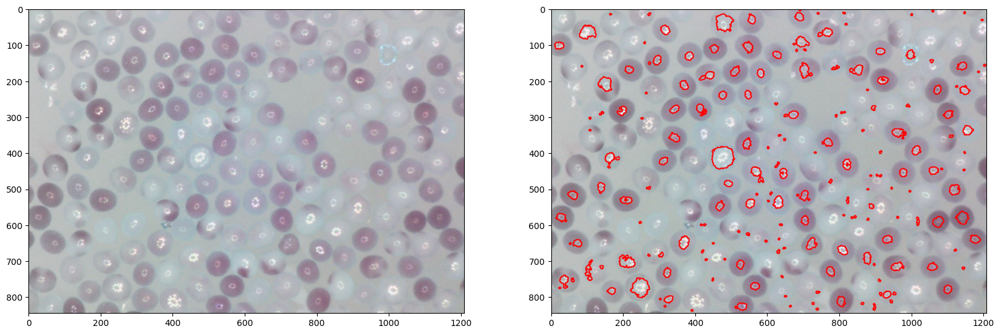

In [10]:
plt.figure(figsize=(20,20))
plt.subplot(121);plt.imshow(bgr)
plt.subplot(122);plt.imshow(bgr_copy_1)

In [ ]:
#importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-12-26-17-03-49.jpg"
bgr=  cv2.imread(input_path)
bgr_gray=  cv2.imread(input_path,0)
bgr_copy_1 = bgr.copy()
lab = cv2.cvtColor(bgr, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

#split into channels
b,g,r = cv2.split(bgr)
#apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(bgr_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 21, 2)
# Fill holes
filled_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)))
img_mask= cv2.dilate(img_mask,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4, 4)),iterations=2)
# subtracting the wbc and platelets mask from the original image
filled_image =(filled_image)-img_mask
# External contours of rbc
contours_ext,hierarchy = cv2.findContours(filled_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contour_data_list_1 =[]


# Assume you have obtained the contours using cv2.findContours()
#contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Get image dimensions
height, width = bgr.shape[:2]

# Create a list to store the non-boundary contours
non_boundary_contours = []

# Iterate through all the contours
for contour in contours:
    # Flag to check if contour touches the boundaries
    is_boundary = False

    # Iterate through all the points in the contour
    for point in contour:
        # Check if any point is touching the boundaries of the image
        x, y = point[0]
        if x == 0 or x == width - 1 or y == 0 or y == height - 1:
            is_boundary = True
            break  # Break the inner loop if any point touches the boundary

    # If the contour is not touching the boundary, add it to the non-boundary contours list
    if not is_boundary:
        non_boundary_contours.append(contour)


cv2.drawContours(bgr_copy_1, non_boundary_contours, -1, (255,0, 0), 2)


# empty dictionary for rbc,wbc, platelets count
Count_1={"RBC":0,"Platelet":0,"WBC":0}
min_contour_area = 250  # Minimum threshold area for rbc
max_contour_area = 1500
contours_new = []
for contour in contours_ext:
    for point in contour:
        x, y = point[0]
        # Check if the contour point lies on the boundaries
        if x != 0 and x != width-1 and y != 0 and y != height-1:
            # Approximate the contour to a closed polygon
            epsilon = 0.02 * cv2.arcLength(contour, True)
            approx = cv2.approxPolyDP(contour, epsilon, True)
        
            # Calculate the contour area
            area = cv2.contourArea(approx)
            x, y, w, h = cv2.boundingRect(approx)
            if area >= min_contour_area and area < max_contour_area:
                M = cv2.moments(approx)
                center_x = int(M["m10"] / M["m00"])
                center_y = int(M["m01"] / M["m00"])
                Count_1["RBC"] += 1
                # Add the contour number as text
                contour_number = str(Count_1["RBC"])
                contours_new.append(approx)
                text_size, _ = cv2.getTextSize(contour_number, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
                text_width, text_height = text_size
                text_x = center_x - int(text_width / 2)
                text_y = center_y + int(text_height / 2)
                #cv2.putText(bgr_copy_1, contour_number, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
                # Add the contour data to the DataFrame
                # Inside the loop, create a dictionary of the contour data
                contour_dict = {"Contour Number": contour_number,
                        "Contour": approx,
                        "Area": area,
                        "Perimeter": cv2.arcLength(approx, True)}
                contour_data_list_1.append(contour_dict)
                # Create a DataFrame from the list of dictionaries
                contour_data_1 = pd.DataFrame(contour_data_list_1)
                #cv2.drawContours(bgr_copy_1, [contour], -1, (255, 0, 0), 2)
rbc_count =Count_1["RBC"]
Count_1["RBC"]=0
outer_rbc_area = np.sum([cv2.contourArea(contour) for contour in contours_new])
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >15:
            
            if contour_hierarchy[3] != -1:
                Count_1["RBC"]+=1
                # Inner contour (Has parent contour)
                inner_rbc_area += area
                
                #cv2.drawContours(bgr_copy_1,[contour],-1,(255,0,0),2)
total_rbc = (Count_1["RBC"]+rbc_count)/2
print("Red sample Blood Report :")
print("Total rbc:",total_rbc)

print("haemoglobin perecentage :Red pigment in the image ",(outer_rbc_area-inner_rbc_area)*100 /outer_rbc_area )

# calculating the MCV of RBCs
"""MCV stands for Mean Corpuscular Volume, and it is a measure of the average volume or size of red blood cells (erythrocytes) in a blood sample.
 It is typically reported in units of femtoliters (fL)."""
def calculate_mcv(contours):
    total_diameter = 0
    num_rbc = 0
    
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > 250:  # Filter out small contours
            num_rbc += 1
            (x, y), (w, h), _ = cv2.fitEllipse(contour)
            diameter = max(w, h)
            total_diameter += diameter
    
    mean_diameter = total_diameter / num_rbc
    mcv = (np.pi / 6) * (mean_diameter**3)
    return mcv

MCV = calculate_mcv(contours_new)
print("MCV :",MCV)

# Function to calculate coarseness
def calculate_coarseness(contour):
    perimeter = cv2.arcLength(contour, True)
    coarseness = perimeter / (2 * np.pi)
    return coarseness

# Function to calculate circularity
def calculate_circularity(contour):
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    circularity = 4 * np.pi * (area / (perimeter * perimeter))
    return circularity

# calculating RDW of rbcs
"""variation in size of red blood cells (erythrocytes) in a blood sample. The RDW value is typically reported as a percentage.
lower rdw less variation in size"""
def calculate_rdw(contours):
    rbc_volumes = []

    for contour in contours:
        contour= cv2.convexHull(contour)
        area = cv2.contourArea(contour)
        radius = np.sqrt(area / np.pi)
        volume = (4/3) * np.pi * radius**3
        rbc_volumes.append(volume)

    mean_cell_volume = np.mean(rbc_volumes)
    rdw = np.std(rbc_volumes) / mean_cell_volume *10
    return rdw
rdw = calculate_rdw(contours_new)
print("RDW:", rdw)

# Finding count  of  WBC and platelets
contours_platelets,_ = cv2.findContours(img_mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
min_contour_area =800
for contour in contours_platelets:
    area = cv2.contourArea(contour)
    if area <min_contour_area:
       #cv2.drawContours(bgr_copy_1,[contour],-1,(0,255,0),2)
       Count_1["Platelet"]=Count_1["Platelet"]+1
    else:
        #cv2.drawContours(bgr_copy_1,[contour],-1,(0,0,255),2)
        Count_1["WBC"]=Count_1["WBC"]+1
plt.figure(figsize=(10,10))
#plt.imshow(bgr_copy_1)
print("Total WBC :",Count_1["WBC"])
print("Total Platelets :",Count_1["Platelet"])


contour_data_1["Coarseness"] = contour_data_1["Contour"].apply(calculate_coarseness)
# Calculate additional features for each contour
contour_data_1["Circularity"] = contour_data_1["Contour"].apply(calculate_circularity)
contour_data=contour_data_1.copy()
#Choosing Normal RBC which are circular in shape and have normal size variation
filtered_normal_contours = contour_data[(contour_data["Coarseness"]>14) & (contour_data["Coarseness"]<21)&(contour_data["Circularity"]>0.80)]
print("Normal RBC :",len(filtered_normal_contours))
print("percentage normal :",len(filtered_normal_contours)*100/total_rbc)
normal = filtered_normal_contours["Contour"].values
plt.figure(figsize=(20,20))
plt.subplot(121);plt.imshow(bgr_copy_1)

'''------------------------------------------------BLUE SAMPLE--------------------------------------------------------------------------'''


plt.figure(figsize=(20,20))
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-10-19-15-03-24.jpg"
bgr=  cv2.imread(input_path)
bgr_gray=cv2.imread(input_path,0)
crop = bgr
crop_copy=crop.copy()
b,g,r = cv2.split(crop)
# Perform histogram equalization on the green channel
g_equalized = cv2.equalizeHist(g)

# Perform contrast stretching
min_intensity = 100
max_intensity = 255
stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)

# Apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 31, 2)


# Fill holes
lab = cv2.cvtColor(crop, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
img_mask_new = cv2.dilate(img_mask,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=2)
#filled_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)))
filled_image = cv2.erode(binary_image,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=1)
filled_image_new = filled_image-img_mask_new


# External contours of rbc
contours_ext,hierarchy = cv2.findContours(filled_image_new, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contour_data_list_2 = []

# empty dictionary for rbc,wbc, platelets count
Count_1={"RBC":0,"Platelet":0,"WBC":0}
min_contour_area = 30
max_contour_area = 5000
contours_new = []
for contour in contours_ext:
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
   
    # Calculate the contour area
    area = cv2.contourArea(approx)
    x, y, w, h = cv2.boundingRect(approx)

    if area >= min_contour_area and area < max_contour_area:
        M = cv2.moments(approx)
        center_x = int(M["m10"] / M["m00"])
        center_y = int(M["m01"] / M["m00"])
        Count_1["RBC"] += 1
        # Add the contour number as text
        contour_number = str(Count_1["RBC"])
        contours_new.append(approx)
        text_size, _ = cv2.getTextSize(contour_number, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
        text_width, text_height = text_size
        text_x = center_x - int(text_width / 2)
        text_y = center_y + int(text_height / 2)
        cv2.putText(bgr_copy_1, contour_number, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
        # Add the contour data to the DataFrame
        contour_data_list_2.append({"Contour Number": contour_number,"Contour" : approx,"Area": area, "Perimeter": cv2.arcLength(approx, True)})
        contour_data_2 = pd.DataFrame(contour_data_list_2)
        cv2.drawContours(bgr_copy_1, [contour], -1, (255, 0, 0), 2)
rbc_count =Count_1["RBC"]
Count_1["RBC"]=0
outer_rbc_area = np.sum([cv2.contourArea(contour) for contour in contours_new])
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image_new, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >15:
            
            if contour_hierarchy[3] != -1:
                Count_1["RBC"]+=1
                # Inner contour (Has parent contour)
                inner_rbc_area += area
                
                #cv2.drawContours(bgr_copy_1,[contour],-1,(255,0,0),2)
total_rbc = (Count_1["RBC"]+rbc_count)/2
print("\nBLUE SAMPLE BLOOD REPORT :")
print("Total rbc:",total_rbc)
print("haemoglobin perecentage :",((outer_rbc_area-inner_rbc_area))*100 /outer_rbc_area )

MCV = calculate_mcv(contours_new)
print("MCV :",MCV)

rdw = calculate_rdw(contours_new)
print("RDW:", rdw)


contour_data_2["Coarseness"] = contour_data_2["Contour"].apply(calculate_coarseness)
# Calculate additional features for each contour
contour_data_2["Circularity"] = contour_data_2["Contour"].apply(calculate_circularity)
contour_data=contour_data_2.copy()
#Choosing Normal RBC which are circular in shape and have normal size variation
filtered_normal_contours = contour_data[(contour_data["Coarseness"]>14) & (contour_data["Coarseness"]<21)&(contour_data["Circularity"]>0.80)]
print("Normal RBC :",len(filtered_normal_contours))
print("percentage normal :",len(filtered_normal_contours)*100/total_rbc)
normal = filtered_normal_contours["Contour"].values
# Display the mask image with only circular contours
min_contour_area = 30
max_contour_area = 5000
perimeters= []
contour_areas = [cv2.contourArea(contour) for contour in contours]
# Find the index of the contour with the largest area
max_area_index = np.argmax(contour_areas)
# Choose the index of the contour you want to smoothen


# Iterate through each contour 
for contour in contours:
    
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
    
    # Calculate the contour area
    area = cv2.contourArea(cv2.convexHull(approx))
    
    # Calculate the perimeter of the contour
    perimeter = cv2.arcLength(approx, True)
    perimeters.append(perimeter)
    convex_contours = []
    # Check if the perimeter is non-zero and contour area is greater than the minimum area
    if area > min_contour_area and area < max_contour_area :
        # Filter contours based on convexity
        #Draw the contour on the mask
        cv2.drawContours(crop_copy, [contour], -1, (255, 0, 0), 2)
#cv2.drawContours(crop_copy, contours_red, -1, (255, 0, 0), 2)
contours_platelets,_ = cv2.findContours(img_mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
min_contour_area =1000
for contour in contours_platelets:
    area = cv2.contourArea(contour)
    if area >min_contour_area:
        cv2.drawContours(crop_copy,[contour],-1,(0,0,255),2)
        Count_1["WBC"]=Count_1["WBC"]+1
    else:
        #cv2.drawContours(crop_copy,[contour],-1,(0,255,0),2)
        Count_1["Platelet"]=Count_1["Platelet"]+1
  
print("Total WBC :",Count_1["WBC"])
print("Total Platelets :",Count_1["Platelet"])
plt.figure(figsize=(20,20))
plt.subplot(122);plt.imshow(crop_copy)




In [ ]:
"""#include <iostream>
#include <opencv2/opencv.hpp>

using namespace cv;

int main()
{
    std::string input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-12-26-17-10-27.jpg";
    Mat bgr = imread(input_path);
    Mat bgr_gray = imread(input_path, 0);
    Mat bgr_copy_1 = bgr.clone();
    Mat lab;
    cvtColor(bgr, lab, COLOR_BGR2LAB);
    Mat img_hsv;
    cvtColor(lab, img_hsv, COLOR_BGR2HSV);

    // Define the lower and upper bounds for the green color in the HSV color space
    Scalar lower_green(40, 130, 170);
    Scalar upper_green(90, 255, 255);

    // Threshold the HSV image based on the color range
    Mat img_mask;
    inRange(img_hsv, lower_green, upper_green, img_mask);

    // Split into channels
    std::vector<Mat> channels;
    split(bgr, channels);
    Mat b = channels[0];
    Mat g = channels[1];
    Mat r = channels[2];

    // Apply adaptive thresholding
    Mat binary_image;
    adaptiveThreshold(bgr_gray, binary_image, 255, ADAPTIVE_THRESH_MEAN_C, THRESH_BINARY_INV, 21, 2);

    // Fill holes
    Mat filled_image;
    morphologyEx(binary_image, filled_image, MORPH_CLOSE, getStructuringElement(MORPH_ELLIPSE, Size(3, 3)));

    // Dilate the mask
    dilate(img_mask, img_mask, getStructuringElement(MORPH_ELLIPSE, Size(4, 4)), Point(-1, -1), 2);

    // Subtract the WBC and platelets mask from the original image
    filled_image = filled_image - img_mask;

    // External contours of RBC
    std::vector<std::vector<Point>> contours_ext;
    std::vector<Vec4i> hierarchy;
    findContours(filled_image, contours_ext, hierarchy, RETR_EXTERNAL, CHAIN_APPROX_SIMPLE);

    // Create an empty vector to store the contour data
    std::vector<std::tuple<int, std::vector<Point>, double, double>> contour_data_1;

    // Empty dictionary for RBC, WBC, platelets count
    std::map<std::string, int> Count_1;
    Count_1["RBC"] = 0;
    Count_1["Platelet"] = 0;
    Count_1["WBC"] = 0;

    double min_contour_area = 250;  // Minimum threshold area for RBC
    double max_contour_area = 2000;
    std::vector<std::vector<Point>> contours_new;

    for (size_t i = 0; i < contours_ext.size(); i++)
    {
        std::vector<Point> contour = contours_ext[i];
        // Approximate the contour to a closed polygon
        double epsilon = 0.02 * arcLength(contour, true);
        std::vector<Point> approx;
        approxPolyDP(contour, approx, epsilon, true);

        // Calculate the contour area
        double area = contourArea(approx);
        Rect boundingRect = boundingRect(approx);
        int x = boundingRect.x;
        int y = boundingRect.y;
        int w = boundingRect.width;
        int h = boundingRect.height;

        if (area >= min_contour_area && area < max_contour_area)
        {
            Moments M = moments(approx);
            int center_x = static_cast<int>(M.m10 / M.m00);
            int center_y = static_cast<int>(M.m01 / M.m00);
            Count_1["RBC"]++;
            // Add the contour number as text
            std::string contour_number = std::to_string(Count_1["RBC"]);
            contours_new.push_back(approx);
            Size text_size = getTextSize(contour_number, FONT_HERSHEY_SIMPLEX, 0.5, 2, nullptr);
            int text_width = text_size.width;
            int text_height = text_size.height;
            int text_x = center_x - static_cast<int>(text_width / 2);
            int text_y = center_y + static_cast<int>(text_height / 2);
            putText(bgr_copy_1, contour_number, Point(text_x, text_y), FONT_HERSHEY_SIMPLEX, 0.5, Scalar(255, 0, 0), 1);
            // Add the contour data to the vector
            contour_data_1.push_back(std::make_tuple(Count_1["RBC"], approx, area, arcLength(approx, true)));
            drawContours(bgr_copy_1, contours_ext, static_cast<int>(i), Scalar(255, 0, 0), 2);
        }
    }

    int rbc_count = Count_1["RBC"];
    Count_1["RBC"] = 0;
    double outer_rbc_area = 0.0;

    for (size_t i = 0; i < contours_new.size(); i++)
    {
        double contour_area = contourArea(contours_new[i]);
        outer_rbc_area += contour_area;
    }

    outer_rbc_area /= contours_new.size();

    // Internal and external contours of RBC
    std::vector<std::vector<Point>> contours;
    findContours(filled_image, contours, hierarchy, RETR_CCOMP, CHAIN_APPROX_SIMPLE);

    double inner_rbc_area = 0.0;
    min_contour_area = 30;

    for (size_t i = 0; i < contours.size(); i++)
    {
        std::vector<Point> contour = contours[i];
        Vec4i contour_hierarchy = hierarchy[i];

        // Calculate the contour area
        double area = contourArea(contour);
        if (area > 15)
        {
            if (contour_hierarchy[3] != -1)
            {
                Count_1["RBC"]++;
                // Inner contour (Has parent contour)
                inner_rbc_area += area;
                drawContours(bgr_copy_1, contours, static_cast<int>(i), Scalar(255, 0, 0), 2);
            }
        }
    }

    double total_rbc = (Count_1["RBC"] + rbc_count) / 2.0;
    std::cout << "Red sample Blood Report :" << std::endl;
    std::cout << "Total RBC: " << total_rbc << std::endl;
    inner_rbc_area /= Count_1["RBC"];
    std::cout << "Haemoglobin Percentage: " << (outer_rbc_area - inner_rbc_area) * 100.0 / outer_rbc_area << std::endl;

    // Calculating the MCV of RBCs
    double total_diameter = 0.0;
    int num_rbc = 0;

    for (const auto& contour : contours_new)
    {
        double area = contourArea(contour);
        if (area > 250.0)
        {
            num_rbc++;
            RotatedRect ellipse = fitEllipse(contour);
            double diameter = std::max(ellipse.size.width, ellipse.size.height);
            total_diameter += diameter;
        }
    }

    double mean_diameter = total_diameter / num_rbc;
    double mcv = (M_PI / 6.0) * std::pow(mean_diameter, 3.0);
    std::cout << "MCV: " << mcv << std::endl;

    // Function to calculate coarseness
    auto calculate_coarseness = [](const std::vector<Point>& contour) {
        double perimeter = arcLength(contour, true);
        double coarseness = perimeter / (2 * M_PI);
        return coarseness;
    };

    // Function to calculate circularity
    auto calculate_circularity = [](const std::vector<Point>& contour) {
        double perimeter = arcLength(contour, true);
        double area = contourArea(contour);
        double circularity = 4 * M_PI * (area / (perimeter * perimeter));
        return circularity;
    };

    std::vector<double> coarseness_values;
    std::vector<double> circularity_values;

    for (const auto& contour : contour_data_1)
    {
        double coarseness = calculate_coarseness(std::get<1>(contour));
        double circularity = calculate_circularity(std::get<1>(contour));
        coarseness_values.push_back(coarseness);
        circularity_values.push_back(circularity);
    }

    // Calculating RDW of RBCs
    std::vector<double> rbc_volumes;

    for (const auto& contour : contours_new)
    {
        std::vector<Point> convex_hull;
        convexHull(contour, convex_hull);
        double area = contourArea(convex_hull);
        double radius = std::sqrt(area / M_PI);
        double volume = (4.0 / 3.0) * M_PI * std::pow(radius, 3.0);
        rbc_volumes.push_back(volume);
    }

    double mean_cell_volume = std::mean(rbc_volumes);
    double rdw = std::sqrt(std::variance(rbc_volumes)) / mean_cell_volume * 10.0;
    std::cout << "RDW: " << rdw << std::endl;

    // Finding count of WBC and platelets
    std::vector<std::vector<Point>> contours_platelets;
    findContours(img_mask, contours_platelets, RETR_EXTERNAL, CHAIN_APPROX_SIMPLE);
    min_contour_area = 600;

    int wbc_count = 0;
    int platelet_count = 0;

    for (const auto& contour : contours_platelets)
    {
        double area = contourArea(contour);
        if (area < min_contour_area)
        {
            drawContours(bgr_copy_1, contours_platelets, static_cast<int>(i), Scalar(0, 255, 0), 2);
            platelet_count++;
        }
        else
        {
            drawContours(bgr_copy_1, contours_platelets, static_cast<int>(i), Scalar(0, 0, 255), 2);
            wbc_count++;
        }
    }

    std::cout << "Total WBC: " << wbc_count << std::endl;
    std::cout << "Total Platelets: " << platelet_count << std::endl;

    std::vector<std::tuple<int, std::vector<Point>, double, double, double>> contour_data_2;

    for (const auto& contour : contours_platelets)
    {
        double area = contourArea(contour);
        double perimeter = arcLength(contour, true);
        double coarseness = calculate_coarseness(contour);
        double circularity = calculate_circularity(contour);
        contour_data_2.push_back(std::make_tuple(0, contour, area, perimeter, coarseness, circularity));
    }

    // Display the processed image with contour numbers
    namedWindow("Processed Image", WINDOW_NORMAL);
    imshow("Processed Image", bgr_copy_1);
    waitKey(0);

    return 0;
}
"""
#---------------------blue sample--------------------------------
"""
#include <iostream>
#include <string>
#include <opencv2/opencv.hpp>

using namespace std;
using namespace cv;

double calculate_coarseness(const vector<Point>& contour)
{
    double perimeter = arcLength(contour, true);
    double coarseness = perimeter / (2 * M_PI);
    return coarseness;
}

double calculate_circularity(const vector<Point>& contour)
{
    double perimeter = arcLength(contour, true);
    double area = contourArea(contour);
    double circularity = 4 * M_PI * (area / (perimeter * perimeter));
    return circularity;
}

double calculate_mcv(const vector<vector<Point>>& contours)
{
    int num_rbc = 0;
    double total_diameter = 0.0;

    for (const auto& contour : contours)
    {
        double area = contourArea(contour);
        if (area > 250.0)
        {
            num_rbc++;
            RotatedRect ellipse = fitEllipse(contour);
            double diameter = max(ellipse.size.width, ellipse.size.height);
            total_diameter += diameter;
        }
    }

    double mean_diameter = total_diameter / num_rbc;
    double mcv = (M_PI / 6.0) * pow(mean_diameter, 3.0);
    return mcv;
}

double calculate_rdw(const vector<vector<Point>>& contours)
{
    vector<double> rbc_volumes;

    for (const auto& contour : contours)
    {
        vector<Point> convex_hull;
        convexHull(contour, convex_hull);
        double area = contourArea(convex_hull);
        double radius = sqrt(area / M_PI);
        double volume = (4.0 / 3.0) * M_PI * pow(radius, 3.0);
        rbc_volumes.push_back(volume);
    }

    double mean_cell_volume = mean(rbc_volumes);
    double rdw = sqrt(variance(rbc_volumes)) / mean_cell_volume * 10.0;
    return rdw;
}

int main()
{
    string input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-10-19-13-50-45.jpg";
    Mat bgr = imread(input_path);
    Mat bgr_gray = imread(input_path, 0);
    Mat crop = bgr.clone();
    Mat crop_copy = crop.clone();

    vector<Mat> channels;
    split(crop, channels);
    Mat g = channels[1];

    // Perform histogram equalization on the green channel
    Mat g_equalized;
    equalizeHist(g, g_equalized);

    // Perform contrast stretching
    int min_intensity = 100;
    int max_intensity = 255;
    Mat stretched;
    normalize(g_equalized, stretched, min_intensity, max_intensity, NORM_MINMAX);

    // Apply adaptive thresholding
    Mat binary_image;
    adaptiveThreshold(stretched, binary_image, 255, ADAPTIVE_THRESH_MEAN_C, THRESH_BINARY_INV, 31, 2);

    // Fill holes
    Mat lab;
    cvtColor(crop, lab, COLOR_BGR2LAB);
    Mat img_hsv;
    cvtColor(lab, img_hsv, COLOR_BGR2HSV);

    // Define the lower and upper bounds for the green color in the HSV color space
    Scalar lower_green(40, 130, 170);
    Scalar upper_green(90, 255, 255);

    // Threshold the HSV image based on the color range
    Mat img_mask;
    inRange(img_hsv, lower_green, upper_green, img_mask);
    Mat img_mask_new;
    dilate(img_mask, img_mask_new, getStructuringElement(MORPH_ELLIPSE, Size(3, 3)), Point(-1, -1), 2);
    Mat filled_image;
    erode(binary_image, filled_image, getStructuringElement(MORPH_ELLIPSE, Size(3, 3)), Point(-1, -1), 1);
    Mat filled_image_new = filled_image - img_mask_new;

    // External contours of rbc
    vector<vector<Point>> contours_ext;
    vector<Vec4i> hierarchy;
    findContours(filled_image_new, contours_ext, hierarchy, RETR_EXTERNAL, CHAIN_APPROX_SIMPLE);

    // Create an empty DataFrame to store the contour data
    vector<tuple<int, vector<Point>, double, double, double, double>> contour_data_2;

    int count_rbc = 0;
    double outer_rbc_area = 0.0;

    for (const auto& contour : contours_ext)
    {
        double area = contourArea(contour);
        if (area >= 30.0 && area < 5000.0)
        {
            double perimeter = arcLength(contour, true);
            double coarseness = calculate_coarseness(contour);
            double circularity = calculate_circularity(contour);
            contour_data_2.push_back(make_tuple(count_rbc, contour, area, perimeter, coarseness, circularity));
            count_rbc++;

            Scalar color(255, 0, 0);
            drawContours(crop_copy, { contour }, -1, color, 2);

            Moments M = moments(contour);
            int center_x = static_cast<int>(M.m10 / M.m00);
            int center_y = static_cast<int>(M.m01 / M.m00);
            string contour_number = to_string(count_rbc);
            Size text_size = getTextSize(contour_number, FONT_HERSHEY_SIMPLEX, 0.5, 2, nullptr);
            int text_width = text_size.width;
            int text_height = text_size.height;
            int text_x = center_x - text_width / 2;
            int text_y = center_y + text_height / 2;
            putText(crop_copy, contour_number, Point(text_x, text_y), FONT_HERSHEY_SIMPLEX, 0.5, Scalar(255, 0, 0), 1);
        }

        outer_rbc_area += area;
    }

    int rbc_count = count_rbc;
    int total_rbc = (count_rbc + rbc_count) / 2;
    cout << "Blue sample Blood Report :" << endl;
    cout << "Total RBC: " << total_rbc << endl;

    double inner_rbc_area = 0.0;
    int min_contour_area = 30;

    vector<vector<Point>> contours;
    findContours(filled_image_new, contours, hierarchy, RETR_CCOMP, CHAIN_APPROX_SIMPLE);

    for (size_t i = 0; i < contours.size(); i++)
    {
        const auto& contour = contours[i];
        const auto& contour_hierarchy = hierarchy[i];

        double area = contourArea(contour);
        if (area > 15.0)
        {
            if (contour_hierarchy[3] != -1)
            {
                count_rbc++;
                inner_rbc_area += area;
            }
        }
    }

    inner_rbc_area /= count_rbc;
    double haemoglobin_percentage = (outer_rbc_area - inner_rbc_area) * 100.0 / outer_rbc_area;
    cout << "Haemoglobin Percentage: " << haemoglobin_percentage << endl;

    double MCV = calculate_mcv(contours_ext);
    cout << "MCV: " << MCV << endl;

    double RDW = calculate_rdw(contours_ext);
    cout << "RDW: " << RDW << endl;

    vector<tuple<int, vector<Point>, double, double, double, double>> filtered_normal_contours;

    for (const auto& contour_data : contour_data_2)
    {
        int contour_number;
        vector<Point> contour;
        double area, perimeter, coarseness, circularity;
        tie(contour_number, contour, area, perimeter, coarseness, circularity) = contour_data;

        if (coarseness > 14.0 && coarseness < 21.0 && circularity > 0.80)
        {
            filtered_normal_contours.push_back(contour_data);
        }
    }

    int normal_rbc_count = filtered_normal_contours.size();
    cout << "Normal RBC: " << normal_rbc_count << endl;
    cout << "Percentage Normal: " << (normal_rbc_count * 100.0) / total_rbc << endl;

    vector<vector<Point>> normal_rbc_contours;
    for (const auto& contour_data : filtered_normal_contours)
    {
        const auto& contour = get<1>(contour_data);
        normal_rbc_contours.push_back(contour);
    }

    // Display the mask image with only circular contours
    int min_contour_area = 30;
    int max_contour_area = 5000;
    vector<double> perimeters;

    vector<double> contour_areas;
    for (const auto& contour : contours)
    {
        double area = contourArea(convexHull(contour));
        contour_areas.push_back(area);

        if (area > min_contour_area && area < max_contour_area)
        {
            double perimeter = arcLength(contour, true);
            perimeters.push_back(perimeter);
            Scalar color(255, 0, 0);
            drawContours(crop_copy, { contour }, -1, color, 2);
        }
    }

    int max_area_index = max_element(contour_areas.begin(), contour_areas.end()) - contour_areas.begin();
    int index_to_smoothen = 0; // Choose the index of the contour you want to smoothen

    // Iterate through each contour
    for (size_t i = 0; i < contours.size(); i++)
    {
        auto& contour = contours[i];
        double area = contourArea(convexHull(contour));
        double perimeter = arcLength(contour, true);
        double coarseness = calculate_coarseness(contour);
        double circularity = calculate_circularity(contour);
        contour_data_2.push_back(make_tuple(i, contour, area, perimeter, coarseness, circularity));

        if (i == index_to_smoothen && area > min_contour_area && area < max_contour_area)
        {
            approxPolyDP(contour, contour, 0.02 * perimeter, true);
            drawContours(crop_copy, { contour }, -1, Scalar(255, 0, 0), 2);
        }
    }

    vector<vector<Point>> contours_platelets;
    findContours(img_mask, contours_platelets, RETR_EXTERNAL, CHAIN_APPROX_SIMPLE);

    int wbc_count = 0;
    int platelet_count = 0;

    for (const auto& contour : contours_platelets)
    {
        double area = contourArea(contour);
        if (area > 150.0)
        {
            RotatedRect ellipse = fitEllipse(contour);
            double circularity = calculate_circularity(contour);

            if (circularity < 0.80)
            {
                wbc_count++;
                Scalar color(0, 0, 255);
                drawContours(crop_copy, { contour }, -1, color, 2);
            }
            else
            {
                platelet_count++;
                Scalar color(0, 255, 0);
                drawContours(crop_copy, { contour }, -1, color, 2);
            }
        }
    }

    cout << "WBC Count: " << wbc_count << endl;
    cout << "Platelet Count: " << platelet_count << endl;

    imshow("Original Image", bgr);
    imshow("Processed Image", crop_copy);
    waitKey(0);

    return 0;
}

"""


In [ ]:
#C++ CODE

"""#include <iostream>
#include <opencv2/opencv.hpp>

int main() {
    std::string input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-12-26-17-10-27.jpg";
    cv::Mat bgr = cv::imread(input_path);
    cv::Mat img_gray = cv::imread(input_path, cv::IMREAD_GRAYSCALE);
    cv::Mat bgr_copy_1 = bgr.clone();
    cv::Mat lab;
    cv::cvtColor(bgr, lab, cv::COLOR_BGR2LAB);
    cv::Mat img_hsv;
    cv::cvtColor(lab, img_hsv, cv::COLOR_BGR2HSV);

    // Define the lower and upper bounds for the green color in the HSV color space
    cv::Scalar lower_green(40, 130, 170);
    cv::Scalar upper_green(90, 255, 255);

    // Threshold the HSV image based on the color range
    cv::Mat img_mask;
    cv::inRange(img_hsv, lower_green, upper_green, img_mask);

    cv::Mat b, g, r;
    cv::split(bgr, { b, g, r });
    cv::Mat binary_image;
    cv::adaptiveThreshold(img_gray, binary_image, 255, cv::ADAPTIVE_THRESH_MEAN_C, cv::THRESH_BINARY_INV, 21, 2);
    // Fill holes
    cv::Mat filled_image;
    cv::morphologyEx(binary_image, filled_image, cv::MORPH_CLOSE, cv::getStructuringElement(cv::MORPH_ELLIPSE, cv::Size(3, 3)));
    cv::dilate(img_mask, img_mask, cv::getStructuringElement(cv::MORPH_ELLIPSE, cv::Size(4, 4)), cv::Point(-1, -1), 2);
    filled_image = filled_image - img_mask;

    std::vector<std::vector<cv::Point>> contours_ext;
    std::vector<cv::Vec4i> hierarchy;
    cv::findContours(filled_image, contours_ext, hierarchy, cv::RETR_EXTERNAL, cv::CHAIN_APPROX_SIMPLE);

    // Create an empty vector to store the contour data
    std::vector<cv::Point> approx;
    std::vector<std::vector<cv::Point>> contours_new;
    int Count_1_RBC = 0;
    double min_contour_area = 250;  // Minimum threshold area for RBC
    double max_contour_area = 2000;

    for (const auto& contour : contours_ext) {
        // Approximate the contour to a closed polygon
        double epsilon = 0.02 * cv::arcLength(contour, true);
        cv::approxPolyDP(contour, approx, epsilon, true);

        // Calculate the contour area
        double area = cv::contourArea(approx);
        cv::Rect boundingRect = cv::boundingRect(approx);

        if (area >= min_contour_area && area < max_contour_area) {
            cv::Moments M = cv::moments(approx);
            int center_x = static_cast<int>(M.m10 / M.m00);
            int center_y = static_cast<int>(M.m01 / M.m00);
            Count_1_RBC++;

            // Add the contour number as text
            std::string contour_number = std::to_string(Count_1_RBC);
            int baseline = 0;
            cv::Size text_size = cv::getTextSize(contour_number, cv::FONT_HERSHEY_SIMPLEX, 0.5, 2, &baseline);
            int text_x = center_x - text_size.width / 2;
            int text_y = center_y + text_size.height / 2;
            cv::putText(bgr_copy_1, contour_number, cv::Point(text_x, text_y), cv::FONT_HERSHEY_SIMPLEX, 0.5, cv::Scalar(255, 0, 0), 1);

            // Add the contour data to the vector
            contours_new.push_back(approx);
            cv::drawContours(bgr_copy_1, { contour }, -1, cv::Scalar(255, 0, 0), 2);
        }
    }

    std::cout << "Number of RBCs: " << Count_1_RBC << std::endl;

    double outer_rbc_area = cv::mean(contours_new, [](const std::vector<cv::Point>& contour) { return cv::contourArea(contour); })[0];
    std::vector<std::vector<cv::Point>> contours;
    std::vector<cv::Vec4i> hierarchy_inner;
    cv::findContours(filled_image, contours, hierarchy_inner, cv::RETR_CCOMP, cv::CHAIN_APPROX_SIMPLE);

    double inner_rbc_area = 0;
    min_contour_area = 30;
    for (size_t i = 0; i < contours.size(); ++i) {
        const auto& contour = contours[i];
        const auto& contour_hierarchy = hierarchy_inner[i];

        // Calculate the contour area
        double area = cv::contourArea(contour);
        if (area > 5) {
            if (contour_hierarchy[3] == -1) {
                // Outer contour (No parent contour)
                // cv::drawContours(crop_copy, contours, static_cast<int>(i), cv::Scalar(255, 0, 0), 2);
            }
            else {
                // Inner contour (Has parent contour)
                inner_rbc_area += area;
                // cv::drawContours(bgr_copy_1, contours, static_cast<int>(i), cv::Scalar(255, 0, 0), 2);
            }
        }
    }

    std::cout << "Number of RBCs: " << Count_1_RBC << std::endl;

    inner_rbc_area /= Count_1_RBC;
    double haemoglobin_percentage = (outer_rbc_area - inner_rbc_area) * 100 / outer_rbc_area;
    std::cout << "Haemoglobin percentage: " << haemoglobin_percentage << std::endl;

    double calculate_mcv(const std::vector<std::vector<cv::Point>>& contours) {
        double total_diameter = 0;
        int num_rbc = 0;

        for (const auto& contour : contours) {
            double area = cv::contourArea(contour);
            if (area > 250) {  // Filter out small contours
                num_rbc++;
                cv::RotatedRect ellipse = cv::fitEllipse(contour);
                double diameter = std::max(ellipse.size.width, ellipse.size.height);
                total_diameter += diameter;
            }
        }

        double mean_diameter = total_diameter / num_rbc;
        double mcv = (M_PI / 6) * std::pow(mean_diameter, 3);
        return mcv;
    }

    double MCV = calculate_mcv(contours_new);
    std::cout << "MCV: " << MCV << std::endl;
    std::cout << "Number of RBCs: " << Count_1_RBC << std::endl;

    double calculate_rdw(const std::vector<std::vector<cv::Point>>& contours) {
        std::vector<double> rbc_volumes;

        for (const auto& contour : contours) {
            std::vector<cv::Point> hull;
            cv::convexHull(contour, hull);
            double area = cv::contourArea(hull);
            double radius = std::sqrt(area / M_PI);
            double volume = (4.0 / 3.0) * M_PI * std::pow(radius, 3);
            rbc_volumes.push_back(volume);
        }

        double mean_cell_volume = cv::mean(rbc_volumes)[0];
        double rdw = cv::standardDeviation(rbc_volumes)[0] / mean_cell_volume * 10;
        return rdw;
    }

    double rdw = calculate_rdw(contours_new);
    std::cout << "RDW: " << rdw << std::endl;

    std::vector<std::vector<cv::Point>> contours_platelets;
    std::vector<cv::Vec4i> hierarchy_platelets;
    cv::findContours(img_mask, contours_platelets, hierarchy_platelets, cv::RETR_EXTERNAL, cv::CHAIN_APPROX_SIMPLE);
    double min_contour_area_platelets = 600;
    int Count_1_Platelet = 0;
    int Count_1_WBC = 0;

    for (const auto& contour : contours_platelets) {
        double area = cv::contourArea(contour);
        if (area < min_contour_area_platelets) {
            cv::drawContours(bgr_copy_1, { contour }, -1, cv::Scalar(0, 255, 0), 2);
            Count_1_Platelet++;
        }
        else {
            cv::drawContours(bgr_copy_1, { contour }, -1, cv::Scalar(0, 0, 255), 2);
            Count_1_WBC++;
        }
    }

    cv::imshow("Result", bgr_copy_1);
    cv::waitKey(0);

    std::cout << "Platelet count: " << Count_1_Platelet << std::endl;
    std::cout << "WBC count: " << Count_1_WBC << std::endl;

    return 0;
}
"""

Extracting Geometrical Features from each RBC 

In [ ]:

# Function to calculate eccentricity
# Function to calculate eccentricity
def calculate_eccentricity(contour):
    if len(contour) < 5:
        return np.nan
    
    ellipse = cv2.fitEllipse(contour)
    (_, _), (min_axis_length, max_axis_length), _ = ellipse
    eccentricity = np.sqrt(1 - (min_axis_length / max_axis_length) ** 2)
    return eccentricity


# Function to calculate solidity
def calculate_solidity(contour):
    hull = cv2.convexHull(contour)
    contour_area = cv2.contourArea(contour)
    hull_area = cv2.contourArea(hull)
    solidity = contour_area / hull_area
    return solidity

# Function to calculate aspect ratio
def calculate_aspect_ratio(contour):
    _, _, w, h = cv2.boundingRect(contour)
    aspect_ratio = w / h
    return aspect_ratio

# Function to calculate orientation
def calculate_orientation(contour):
    if len(contour) < 5:
        return np.nan
    (_, _), (_, _), angle = cv2.fitEllipse(contour)
    return angle


# Function to calculate Hu moments
def calculate_hu_moments(contour):
    moments = cv2.moments(contour)
    hu_moments = cv2.HuMoments(moments).flatten()
    return hu_moments

# Function to calculate Haralick texture features
def calculate_haralick_features(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    textures = mahotas.features.haralick(gray)
    haralick_features = textures.mean(axis=0)
    return haralick_features

# Function to calculate Fourier descriptors
def calculate_fourier_descriptors(contour):
    contour_complex = contour[:, 0, 0] + 1j * contour[:, 0, 1]
    fourier_descriptors = np.fft.fft(contour_complex)
    return fourier_descriptors



# Function to calculate Zernike moments
def calculate_zernike_moments(contour):
    moments = cv2.moments(contour)
    centroid_x = int(moments["m10"] / moments["m00"])
    centroid_y = int(moments["m01"] / moments["m00"])
    normalized_moments = cv2.moments(contour, True)
    zernike_moments = mahotas.features.zernike_moments(normalized_moments, centroid=(centroid_y, centroid_x))
    return zernike_moments

# Function to calculate circularity
def calculate_circularity(contour):
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    circularity = 4 * np.pi * (area / (perimeter * perimeter))
    return circularity

# Function to calculate centroid
def calculate_centroid(contour):
    M = cv2.moments(contour)
    centroid_x = int(M["m10"] / M["m00"])
    centroid_y = int(M["m01"] / M["m00"])
    return centroid_x, centroid_y

# Function to calculate medial axis ratio
def calculate_medial_axis_ratio(contour):
    _, _, w, h = cv2.boundingRect(contour)
    if h == 0:
        return 0
    return w / h

# Function to calculate cell deform ratio
def calculate_cell_deform_ratio(contour):
    _, _, w, h = cv2.boundingRect(contour)
    if w == 0:
        return 0
    return h / w

# Function to calculate roughness
def calculate_roughness(contour):
    hull = cv2.convexHull(contour)
    hull_area = cv2.contourArea(hull)
    contour_area = cv2.contourArea(contour)
    roughness = (hull_area - contour_area) / contour_area
    return roughness

# Function to calculate regularity
def calculate_regularity(contour):
    _, radius = cv2.minEnclosingCircle(contour)
    area = cv2.contourArea(contour)
    regularity = area / (np.pi * radius * radius)
    return regularity

# Function to calculate uniformity
def calculate_uniformity(contour):
    area = cv2.contourArea(contour)
    uniformity = np.sqrt(area / np.pi)
    return uniformity

# Function to calculate coarseness
def calculate_coarseness(contour):
    perimeter = cv2.arcLength(contour, True)
    coarseness = perimeter / (2 * np.pi)
    return coarseness
def calculate_rdw(contours):
    rbc_sizes = []

    for contour in contours:
        area = cv2.contourArea(contour)
        rbc_sizes.append(area)

    rdw = np.std(rbc_sizes) / np.mean(rbc_sizes) * 100
    return rdw
import math
def compute_area_ratio(contour):
    perimeter = cv2.arcLength(contour, True)
    radius = perimeter / (2 * math.pi)
    area_cell = cv2.contourArea(contour)
    area_circle = math.pi * radius ** 2
    area_ratio = area_cell / area_circle
    return area_ratio

def compute_compactness(contour):
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    compactness = (perimeter ** 2) / area
    return compactness

def compute_curvature(contour):
    contour = np.array(contour, dtype=np.int32) 
    # Compute the curvature at each point along the contour
    curvature = []
    for i in range(len(contour)):
        prev_pt = contour[i-1, 0]
        curr_pt = contour[i, 0]
        next_pt = contour[(i+1) % len(contour), 0]
        
        # Calculate the curvature using the three neighboring points
        curvature_i = compute_curvature_at_point(prev_pt, curr_pt, next_pt)
        curvature.append(curvature_i/100)
    return curvature

def compute_curvature_at_point(prev_pt, curr_pt, next_pt):
    # Compute the curvature at a single point using finite difference method
    x1, y1 = prev_pt
    x2, y2 = curr_pt
    x3, y3 = next_pt
    
    # Compute the cross product of the vectors
    cross_product = (x1 - x2) * (y3 - y2) - (y1 - y2) * (x3 - x2)
    
    # Compute the squared distance between the points
    distance_squared = ((x3 - x2) ** 2) + ((y3 - y2) ** 2)
    
    # Compute the curvature using the formula: curvature = cross_product / distance_squared
    curvature = cross_product / distance_squared
    
    return curvature



# Calculate additional features for each contour
contour_data_1["Circularity"] = contour_data_1["Contour"].apply(calculate_circularity)
#contour_data[["Centroid_X", "Centroid_Y"]] = pd.DataFrame(contour_data["Contour"].apply(calculate_centroid).tolist())
contour_data_1["Medial_Axis_Ratio"] = contour_data_1["Contour"].apply(calculate_medial_axis_ratio)
contour_data_1["Cell_Deform_Ratio"] = contour_data_1["Contour"].apply(calculate_cell_deform_ratio)
contour_data_1["Roughness"] = contour_data_1["Contour"].apply(calculate_roughness)
contour_data_1["Regularity"] = contour_data_1["Contour"].apply(calculate_regularity)
contour_data_1["Uniformity"] = contour_data_1["Contour"].apply(calculate_uniformity)
contour_data_1["Coarseness"] = contour_data_1["Contour"].apply(calculate_coarseness)

# Calculate additional features for each contour
contour_data_1["Eccentricity"] = contour_data_1["Contour"].apply(calculate_eccentricity)
contour_data_1["Solidity"] = contour_data_1["Contour"].apply(calculate_solidity)
contour_data_1["Aspect_Ratio"] = contour_data_1["Contour"].apply(calculate_aspect_ratio)
contour_data_1["Orientation"] = contour_data_1["Contour"].apply(calculate_orientation)
contour_data_1["Compactness"] = contour_data_1["Contour"].apply(compute_compactness)
contour_data_1["Curvature"] = contour_data_1["Contour"].apply(compute_curvature)
contour_data_1["Area_Ratio"] = contour_data_1["Contour"].apply(compute_area_ratio)
#copy contour_data_1 to contour_data
contour_data=contour_data_1.copy()
#Choosing Normal RBC which are circular in shape and have normal size variation
filtered_normal_contours = contour_data[(contour_data["Coarseness"]>14) & (contour_data["Coarseness"]<21)&(contour_data["Circularity"]>0.80)]
len(filtered_normal_contours)
normal = filtered_normal_contours["Contour"].values

In [ ]:
"""#include <opencv2/opencv.hpp>
#include <vector>
#include <cmath>

// Define the additional feature calculation functions
double calculateCircularity(const std::vector<cv::Point>& contour) {
    double perimeter = cv::arcLength(contour, true);
    double area = cv::contourArea(contour);
    double circularity = (4 * M_PI * area) / (perimeter * perimeter);
    return circularity;
}

double calculateMedialAxisRatio(const std::vector<cv::Point>& contour) {
    cv::Rect boundingRect = cv::boundingRect(contour);
    double medialAxisRatio = static_cast<double>(boundingRect.width) / boundingRect.height;
    return medialAxisRatio;
}

double calculateCellDeformRatio(const std::vector<cv::Point>& contour) {
    cv::Rect boundingRect = cv::boundingRect(contour);
    double cellDeformRatio = static_cast<double>(boundingRect.height) / boundingRect.width;
    return cellDeformRatio;
}

double calculateRoughness(const std::vector<cv::Point>& contour) {
    std::vector<cv::Point> hull;
    cv::convexHull(contour, hull);
    double hullArea = cv::contourArea(hull);
    double contourArea = cv::contourArea(contour);
    double roughness = (hullArea - contourArea) / contourArea;
    return roughness;
}

double calculateRegularity(const std::vector<cv::Point>& contour) {
    cv::Point2f center;
    float radius;
    cv::minEnclosingCircle(contour, center, radius);
    double area = cv::contourArea(contour);
    double regularity = area / (M_PI * radius * radius);
    return regularity;
}

double calculateUniformity(const std::vector<cv::Point>& contour) {
    double area = cv::contourArea(contour);
    double uniformity = std::sqrt(area / M_PI);
    return uniformity;
}

double calculateCoarseness(const std::vector<cv::Point>& contour) {
    double perimeter = cv::arcLength(contour, true);
    double coarseness = perimeter / (2 * M_PI);
    return coarseness;
}

double calculateEccentricity(const std::vector<cv::Point>& contour) {
    if (contour.size() < 5) {
        return NAN;
    }
    cv::RotatedRect ellipse = cv::fitEllipse(contour);
    cv::Size2f size = ellipse.size;
    double minAxisLength = std::min(size.width, size.height);
    double maxAxisLength = std::max(size.width, size.height);
    double eccentricity = std::sqrt(1 - (minAxisLength / maxAxisLength) * (minAxisLength / maxAxisLength));
    return eccentricity;
}

double calculateSolidity(const std::vector<cv::Point>& contour) {
    std::vector<cv::Point> hull;
    cv::convexHull(contour, hull);
    double contourArea = cv::contourArea(contour);
    double hullArea = cv::contourArea(hull);
    double solidity = contourArea / hullArea;
    return solidity;
}

double calculateAspectRatio(const std::vector<cv::Point>& contour) {
    cv::Rect boundingRect = cv::boundingRect(contour);
    double aspectRatio = static_cast<double>(boundingRect.width) / boundingRect.height;
    return aspectRatio;
}

double calculateOrientation(const std::vector<cv::Point>& contour) {
    if (contour.size() < 5) {
        return NAN;
    }
    cv::RotatedRect ellipse = cv::fitEllipse(contour);
    double angle = ellipse.angle;
    return angle;
}

double computeCompactness(const std::vector<cv::Point>& contour) {
    double perimeter = cv::arcLength(contour, true);
    double area = cv::contourArea(contour);
    double compactness = perimeter * perimeter / area;
    return compactness;
}

std::vector<double> computeCurvature(const std::vector<cv::Point>& contour) {
    std::vector<cv::Point> paddedContour;
    paddedContour.push_back(contour.back());
    paddedContour.insert(paddedContour.end(), contour.begin(), contour.end());
    paddedContour.push_back(contour.front());

    std::vector<double> curvature;
    for (size_t i = 1; i < paddedContour.size() - 1; ++i) {
        cv::Point prevPt = paddedContour[i - 1];
        cv::Point currPt = paddedContour[i];
        cv::Point nextPt = paddedContour[i + 1];

        double crossProduct = (prevPt.x - currPt.x) * (nextPt.y - currPt.y) -
                              (prevPt.y - currPt.y) * (nextPt.x - currPt.x);
        double distanceSquared = pow(nextPt.x - currPt.x, 2) + pow(nextPt.y - currPt.y, 2);
        double curvatureI = crossProduct / distanceSquared;
        curvature.push_back(curvatureI / 100.0);  // Divide by 100 to scale the curvature
    }

    return curvature;
}

double computeAreaRatio(const std::vector<cv::Point>& contour) {
    double perimeter = cv::arcLength(contour, true);
    double radius = perimeter / (2 * M_PI);
    double areaCell = cv::contourArea(contour);
    double areaCircle = M_PI * pow(radius, 2);
    double areaRatio = areaCell / areaCircle;
    return areaRatio;
}

int main() {
    // Load and process contour data
    // ...

    // Calculate additional features for each contour
    for (size_t i = 0; i < contour_data.size(); ++i) {
        const std::vector<cv::Point>& contour = contour_data[i].Contour;
        contour_data[i].Circularity = calculateCircularity(contour);
        contour_data[i].Medial_Axis_Ratio = calculateMedialAxisRatio(contour);
        contour_data[i].Cell_Deform_Ratio = calculateCellDeformRatio(contour);
        contour_data[i].Roughness = calculateRoughness(contour);
        contour_data[i].Regularity = calculateRegularity(contour);
        contour_data[i].Uniformity = calculateUniformity(contour);
        contour_data[i].Coarseness = calculateCoarseness(contour);
        contour_data[i].Eccentricity = calculateEccentricity(contour);
        contour_data[i].Solidity = calculateSolidity(contour);
        contour_data[i].Aspect_Ratio = calculateAspectRatio(contour);
        contour_data[i].Orientation = calculateOrientation(contour);
        contour_data[i].Compactness = computeCompactness(contour);
        contour_data[i].Curvature = computeCurvature(contour);
        contour_data[i].Area_Ratio = computeAreaRatio(contour);
    }

    return 0;
}
"""

Plots of various features for each contour

In [ ]:
!pip install nbformat


In [ ]:
import pandas as pd
import plotly.graph_objects as go


contour_data= contour_data.sort_values("Aspect_Ratio")
# Create a scatter plot for the contour number vs area
fig1 = go.Figure()
fig1.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Aspect_Ratio"],
    mode='markers',
    marker=dict(color="red"),
    name="Aspect_Ratio"
))
fig1.update_layout(
    title="Contour Number vs Aspect_Ratio",
    xaxis_title="Contour Number",
    yaxis_title="Aspect_Ratio"
)
fig1.show()
contour_data= contour_data.sort_values("Eccentricity")
# Create a scatter plot for the contour number vs perimeter
fig2 = go.Figure()
fig2.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Eccentricity"],
    mode='markers',
    marker=dict(color="blue"),
    name="Eccentricity"
))
fig2.update_layout(
    title="Contour Number vs Eccentricity",
    xaxis_title="Contour Number",
    yaxis_title="Eccentricity"
)
fig2.show()
contour_data= contour_data.sort_values("Cell_Deform_Ratio")
# Create a scatter plot for the contour number vs perimeter
fig3 = go.Figure()
fig3.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Cell_Deform_Ratio"],
    mode='markers',
    marker=dict(color="blue"),
    name="Cell_deform_ratio"
))
fig3.update_layout(
    title="Contour Number vs cell_ deform ratio",
    xaxis_title="Contour Number",
    yaxis_title="Cell_Deform_Ratio"
)
fig3.show()

contour_data= contour_data.sort_values("Solidity")
# Create a scatter plot for the contour number vs perimeter
fig4 = go.Figure()
fig4.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Solidity"],
    mode='markers',
    marker=dict(color="blue"),
    name="Solidty"
))
fig4.update_layout(
    title="Contour Number vs Solidity",
    xaxis_title="Contour Number",
    yaxis_title="Solidity"
)
fig4.show()

contour_data= contour_data.sort_values("Roughness")
# Create a scatter plot for the contour number vs perimeter
fig5 = go.Figure()
fig5.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Roughness"],
    mode='markers',
    marker=dict(color="blue"),
    name="Solidty"
))
fig5.update_layout(
    title="Contour Number vs Roughness",
    xaxis_title="Contour Number",
    yaxis_title="Roughness"
)
fig5.show()
print("Higher Roughness feature values helps to detect the irregular shape")

contour_data= contour_data.sort_values("Compactness")
# Create a scatter plot for the contour number vs perimeter
fig6 = go.Figure()
fig6.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Compactness"],
    marker=dict(color="blue"),
    name="Compactness"
))
fig6.update_layout(
    title="Contour Number vs Compactness",
    xaxis_title="Contour Number",
    yaxis_title="Compactness")
fig6.show()
contour_data= contour_data.sort_values("Area_Ratio")
# Create a scatter plot for the contour number vs perimeter
fig7 = go.Figure()
fig7.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Area_Ratio"],
    marker=dict(color="blue"),
    name="Area_rati0"))
fig7.update_layout(
    title="Contour Number vs Area_Ratio",
    xaxis_title="Contour Number",
    yaxis_title="Area_Ratio")
fig7.show()

contour_data= contour_data.sort_values("Coarseness")
# Create a scatter plot for the contour number vs perimeter
fig8 = go.Figure()
fig8.add_trace(go.Scatter(
    x=contour_data["Contour Number"],
    y=contour_data["Coarseness"],
    marker=dict(color="blue"),
    name="Coarseness"))
fig8.update_layout(
    title="Contour Number vs Area_Ratio",
    xaxis_title="Contour Number",
    yaxis_title="Coarseness")
fig8.show()


RBC SEGMENTATION FOR BLUE SAMPLE

In [ ]:
plt.figure(figsize=(20,20))
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-10-19-13-50-45.jpg"
bgr=  cv2.imread(input_path)
bgr_gray=cv2.imread(input_path,0)
crop = bgr
crop_copy=crop.copy()
b,g,r = cv2.split(crop)
# Perform histogram equalization on the green channel
g_equalized = cv2.equalizeHist(g)

# Perform contrast stretching
min_intensity = 100
max_intensity = 255
stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)

# Apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 31, 2)


# Fill holes
lab = cv2.cvtColor(crop, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
img_mask_new = cv2.dilate(img_mask,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=2)
#filled_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)))
filled_image = cv2.erode(binary_image,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=1)
filled_image_new = filled_image-img_mask_new


# External contours of rbc
contours_ext,hierarchy = cv2.findContours(filled_image_new, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Create an empty DataFrame to store the contour data
contour_data_2 = pd.DataFrame(columns=["Contour Number", "Contour","Area", "Perimeter"])
# empty dictionary for rbc,wbc, platelets count
Count_1={"RBC":0,"Platelet":0,"WBC":0}
min_contour_area = 30
max_contour_area = 5000
contours_new = []
for contour in contours_ext:
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
   
    # Calculate the contour area
    area = cv2.contourArea(approx)
    x, y, w, h = cv2.boundingRect(approx)

    if area >= min_contour_area and area < max_contour_area:
        M = cv2.moments(approx)
        center_x = int(M["m10"] / M["m00"])
        center_y = int(M["m01"] / M["m00"])
        Count_1["RBC"] += 1
        # Add the contour number as text
        contour_number = str(Count_1["RBC"])
        contours_new.append(approx)
        text_size, _ = cv2.getTextSize(contour_number, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
        text_width, text_height = text_size
        text_x = center_x - int(text_width / 2)
        text_y = center_y + int(text_height / 2)
        cv2.putText(bgr_copy_1, contour_number, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
        # Add the contour data to the DataFrame
        contour_data_2 = contour_data_2.append({"Contour Number": contour_number,"Contour" : approx,"Area": area, "Perimeter": cv2.arcLength(approx, True)},ignore_index=True)
        cv2.drawContours(bgr_copy_1, [contour], -1, (255, 0, 0), 2)
rbc_count =Count_1["RBC"]
Count_1["RBC"]=0
outer_rbc_area = np.mean([cv2.contourArea(contour) for contour in contours_new])
# Internal and external contours of rbc
contours, hierarchy = cv2.findContours(filled_image_new, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

inner_rbc_area = 0
min_contour_area = 30
for i in range(len(contours)):
    contour = contours[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >15:
            
            if contour_hierarchy[3] != -1:
                Count_1["RBC"]+=1
                # Inner contour (Has parent contour)
                inner_rbc_area += area
                
                #cv2.drawContours(bgr_copy_1,[contour],-1,(255,0,0),2)
total_rbc = (Count_1["RBC"]+rbc_count)/2
print("Total rbc:",total_rbc)
inner_rbc_area = inner_rbc_area/Count_1["RBC"]
print("haemoglobin perecentage :",(outer_rbc_area-inner_rbc_area)*100 /outer_rbc_area )

# calculating the MCV of RBCs
def calculate_mcv(contours):
    total_diameter = 0
    num_rbc = 0
    
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > 250:  # Filter out small contours
            num_rbc += 1
            (x, y), (w, h), _ = cv2.fitEllipse(contour)
            diameter = max(w, h)
            total_diameter += diameter
    
    mean_diameter = total_diameter / num_rbc
    mcv = (np.pi / 6) * (mean_diameter**3)
    return mcv

MCV = calculate_mcv(contours_new)
print("MCV :",MCV)


# calculating RDW of rbcs
def calculate_rdw(contours):
    rbc_volumes = []

    for contour in contours:
        contour= cv2.convexHull(contour)
        area = cv2.contourArea(contour)
        radius = np.sqrt(area / np.pi)
        volume = (4/3) * np.pi * radius**3
        rbc_volumes.append(volume)

    mean_cell_volume = np.mean(rbc_volumes)
    rdw = np.std(rbc_volumes) / mean_cell_volume *10
    return rdw
rdw = calculate_rdw(contours_new)
print("RDW:", rdw)

# Function to calculate coarseness
def calculate_coarseness(contour):
    perimeter = cv2.arcLength(contour, True)
    coarseness = perimeter / (2 * np.pi)
    return coarseness

# Function to calculate circularity
def calculate_circularity(contour):
    perimeter = cv2.arcLength(contour, True)
    area = cv2.contourArea(contour)
    circularity = 4 * np.pi * (area / (perimeter * perimeter))
    return circularity

contour_data_2["Coarseness"] = contour_data_2["Contour"].apply(calculate_coarseness)
# Calculate additional features for each contour
contour_data_2["Circularity"] = contour_data_2["Contour"].apply(calculate_circularity)
contour_data=contour_data_2.copy()
#Choosing Normal RBC which are circular in shape and have normal size variation
filtered_normal_contours = contour_data[(contour_data["Coarseness"]>14) & (contour_data["Coarseness"]<21)&(contour_data["Circularity"]>0.80)]
print("Normal RBC :",len(filtered_normal_contours))
print("percentage normal :",len(filtered_normal_contours)*100/total_rbc)
normal = filtered_normal_contours["Contour"].values
# Display the mask image with only circular contours
min_contour_area = 30
max_contour_area = 5000
perimeters= []
contour_areas = [cv2.contourArea(contour) for contour in contours]
# Find the index of the contour with the largest area
max_area_index = np.argmax(contour_areas)
# Choose the index of the contour you want to smoothen


# Iterate through each contour 
for contour in contours:
    
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
    
    # Calculate the contour area
    area = cv2.contourArea(cv2.convexHull(approx))
    
    # Calculate the perimeter of the contour
    perimeter = cv2.arcLength(approx, True)
    perimeters.append(perimeter)
    convex_contours = []
    # Check if the perimeter is non-zero and contour area is greater than the minimum area
    if area > min_contour_area and area < max_contour_area :
        # Filter contours based on convexity
        #Draw the contour on the mask
        cv2.drawContours(crop_copy, [contour], -1, (255, 0, 0), 2)
#cv2.drawContours(crop_copy, contours_red, -1, (255, 0, 0), 2)
contours_platelets,_ = cv2.findContours(img_mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
min_contour_area =1000
for contour in contours_platelets:
    area = cv2.contourArea(contour)
    if area <min_contour_area:
       cv2.drawContours(crop_copy,[contour],-1,(0,255,0),2)
       Count_1["Platelet"]=Count_1["Platelet"]+1
    else:
        cv2.drawContours(crop_copy,[contour],-1,(0,0,255),2)
        Count_1["WBC"]=Count_1["WBC"]+1

print("Total WBC :",Count_1["WBC"])
print("Total Platelets :",Count_1["Platelet"])
plt.figure(figsize=(10,10))
plt.imshow(crop_copy)



In [ ]:
plt.figure(figsize=(20,20))
input_path = "C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample\\2022-10-19-13-50-45.jpg"
bgr=  cv2.imread(input_path)
bgr_gray=cv2.imread(input_path,0)
crop = bgr
crop_copy=crop.copy()
b,g,r = cv2.split(crop)
# Perform histogram equalization on the green channel
g_equalized = cv2.equalizeHist(g)

# Perform contrast stretching
min_intensity = 100
max_intensity = 255
stretched = cv2.normalize(g_equalized, None, min_intensity, max_intensity, cv2.NORM_MINMAX)

# Apply adaptive thresholding
binary_image = cv2.adaptiveThreshold(stretched, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 31, 2)


# Fill holes
lab = cv2.cvtColor(crop, cv2.COLOR_BGR2LAB)
img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

# Define the lower and upper bounds for the green color in the HSV color space
lower_green = np.array([40, 130, 170])
upper_green = np.array([90, 255, 255])

# Threshold the HSV image based on the color range
img_mask = cv2.inRange(img_hsv, lower_green, upper_green)
img_mask_new = cv2.dilate(img_mask,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=2)
#filled_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)))
filled_image = cv2.erode(binary_image,kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3)),iterations=1)
filled_image_new = filled_image-img_mask_new

def calculate_mcv(contours):
    total_diameter = 0
    num_rbc = 0
    
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > 30:  # Filter out small contours
            num_rbc += 1
            (x, y), (w, h), _ = cv2.fitEllipse(contour)
            diameter = max(w, h)
            total_diameter += diameter
    
    mean_diameter = total_diameter / num_rbc
    mcv = (np.pi / 6) * (mean_diameter**3)
    return mcv


def calculate_rdw(contours):
    rbc_volumes = []

    for contour in contours:
        contour= cv2.convexHull(contour)
        area = cv2.contourArea(contour)
        radius = np.sqrt(area / np.pi)
        volume = (4/3) * np.pi * radius**3
        rbc_volumes.append(volume)

    mean_cell_volume = np.mean(rbc_volumes)
    rdw = np.std(rbc_volumes) / mean_cell_volume *10
    return rdw
contours,_ = cv2.findContours(filled_image_new,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)

MCV = calculate_mcv(contours)
print("MCV :",MCV)
print("RDW :",calculate_rdw(contours))
print(len(contours))
contours_blu,hierarchy = cv2.findContours(filled_image_new, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(crop_copy,contours,-1,(255,0,0),2)
# Define the circularity threshold and minimum contour area (adjust these values as per your requirement)
circularity_threshold = 0.8


#creating a dictionary for storing counts of wbc rbc and platelets
count ={"RBC":0,"WBC":0,"Platelets":0}
perimeters =[]
outer_contour_area = 0
inner_contour_area = 0
min_contour_area = 30
for i in range(len(contours_blu)):
    contour = contours_blu[i]
    contour_hierarchy = hierarchy[0][i]
    # Calculate the perimeter of the contour
    
    # Calculate the contour area
    area = cv2.contourArea(contour)
    if area >5:
            if contour_hierarchy[3] == -1:
                
                # Outer contour (No parent contour)
                    outer_contour_area += area
                    epsilon = 0.02 * cv2.arcLength(contour, True)
                    approx = cv2.approxPolyDP(contour, epsilon, True)
                    area = cv2.contourArea(cv2.convexHull(approx))
                    
                # Calculate the perimeter of the contour
                    perimeter = cv2.arcLength(approx, True)
                    perimeters.append(perimeter)

                    #cv2.drawContours(crop_copy,[contour],-1,(255,0,0),2)
                
            else:
                # Inner contour (Has parent contour)
                inner_contour_area += area
                count["RBC"]=count["RBC"]+1
                #cv2.drawContours(crop_copy,[contour],-1,(255,0,0),2)

total_area= outer_contour_area
hemoglobin_percentage = (outer_contour_area - inner_contour_area) * 100 / total_area
print("Percentage of Hemoglobin:", hemoglobin_percentage)

# Iterate through each contour
for contour in contours_blu:
    
    # Approximate the contour to a closed polygon
    epsilon = 0.02 * cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
    
    # Calculate the contour area
    area = cv2.contourArea(cv2.convexHull(approx))
    
    # Calculate the perimeter of the contour
    perimeter = cv2.arcLength(approx, True)
    #perimeters.append(perimeter)
    convex_contours = []
    # Check if the perimeter is non-zero and contour area is greater than the minimum area
    if area > min_contour_area and area < max_contour_area :
        # Filter contours based on convexity
        #Draw the contour on the mask
        
        cv2.drawContours(crop_copy, [contour], -1, (255, 0, 0), 2)
#cv2.drawContours(crop_copy, contours_blu, -1, (255, 0, 0), 2)
contours_platelets,_ = cv2.findContours(img_mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
min_contour_area =100

for contour in contours_platelets:
    area = cv2.contourArea(contour)
    if area <min_contour_area:
       #cv2.drawContours(crop_copy,[contour],-1,(0,255,0),2)
       count["Platelets"]+=1
    else:
        #cv2.drawContours(crop_copy,[contour],-1,(0,0,255),2)
        count["WBC"]+=1
print(" ",count.keys()," :",count.values())
plt.figure(figsize=(10,10))
plt.imshow(crop_copy)



In [ ]:
hierarchy[0][301][3]

In [ ]:
import os
import cv2
import csv
import numpy as np
import matplotlib.pyplot as plt


class WBCCounter:
    def __init__(self, input_folder, output_folder):
        self.input_folder = input_folder
        self.output_folder = output_folder

    def process_images(self):
        images = []
        file_path = []
        for file_name in os.listdir(self.input_folder):
            if file_name.endswith('.jpg') or file_name.endswith('.jpeg') or file_name.endswith('.png'):
                image_file_path = os.path.join(self.input_folder, file_name)
                file_path.append(image_file_path)
                images.append(cv2.imread(image_file_path))

    
        processed_img_list = []
        final_image = []
        wbc_count_per_image = []
        for i, img in enumerate(images):
            pad = 30
            padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)),
                                mode='constant', constant_values=255)
            lab = cv2.cvtColor(padded_img, cv2.COLOR_BGR2LAB)

            cv2.imwrite("lab_img.jpg", lab)
            lab = cv2.imread("lab_img.jpg")
            lab = cv2.cvtColor(lab, cv2.COLOR_BGR2RGB)
            img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

            lower_green = np.array([40, 130, 170])
            upper_green = np.array([90, 255, 255])

            img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

            contours, hierarchy = cv2.findContours(
                img_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            img_res = padded_img.copy()
            wbc_count = 0
            for cnt in contours:
                x, y, w, h = cv2.boundingRect(cnt)
                if w > 20 and h > 20:
                    wbc_count += 1
                    center_x = x + w // 2
                    center_y = y + h // 2
                    crop_size = 150
                    crop_x = center_x - crop_size // 2
                    crop_y = center_y - crop_size // 2
                    cropped_img = padded_img[crop_y:crop_y +
                                             crop_size, crop_x:crop_x+crop_size]
                    final_image.append(cropped_img)

            wbc_count_per_image.append([file_path[i], wbc_count])
            processed_img_list.append(img_res)

        with open("wbc_counts.csv", "w", newline="") as csvfile:
            writer = csv.writer(csvfile)
            writer.writerow(["Filename", "WBC Count"])
            writer.writerows(wbc_count_per_image)

        os.makedirs(self.output_folder, exist_ok=True)

        for i in range(len(final_image)):
            if final_image[i] is None or final_image[i].size == 0:
                continue
            resized_image = cv2.resize(final_image[i], (416, 416))
            output_filename = os.path.join(
                self.output_folder, f"final_image{i}.jpg")
            cv2.imwrite(output_filename, resized_image)

    def run_object_detection(self):
        yolov5_folder = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\YOLOV5_lib'
        weights_path = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\weights_100epochs\\best.pt'
        source_folder = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\Notebooks\\cropped_images8'

        # Change the current working directory
        os.chdir(yolov5_folder)

        # Run YOLOv5 object detection
       
        !python detect.py --weights {weights_path} --img 416 --conf 0.4 --source {source_folder}
        print("done")





In [ ]:

# Example usage
input_folder_path = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\image_sample'
output_folder_path = 'C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\Notebooks\\cropped_images8'

wbc_counter = WBCCounter(input_folder_path, output_folder_path)
wbc_counter.process_images()
wbc_counter.run_object_detection()

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import math
import csv

def process_images(image_folder_path, output_folder):
    images = []
    file_path = []
    for file_name in os.listdir(image_folder_path):
        if file_name.endswith('.jpg') or file_name.endswith('.jpeg') or file_name.endswith('.png'):
            image_file_path = os.path.join(image_folder_path, file_name)
            file_path.append(image_file_path)
            images.append(cv2.imread(image_file_path))

    plt.figure(figsize=(20, 20))
    processed_img_list = []
    final_image = []
    wbc_count_per_image = []
    for i, img in enumerate(images):
        pad = 30
        padded_img = np.pad(img, ((pad, pad), (pad, pad), (0, 0)),
                            mode='constant', constant_values=255)
        lab = cv2.cvtColor(padded_img, cv2.COLOR_BGR2LAB)

        cv2.imwrite("lab_img.jpg", lab)
        lab = cv2.imread("lab_img.jpg")
        lab = cv2.cvtColor(lab, cv2.COLOR_BGR2RGB)
        img_hsv = cv2.cvtColor(lab, cv2.COLOR_BGR2HSV)

        lower_green = np.array([40, 130, 170])
        upper_green = np.array([90, 255, 255])

        img_mask = cv2.inRange(img_hsv, lower_green, upper_green)

        contours, hierarchy = cv2.findContours(
            img_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        img_res = padded_img.copy()
        wbc_count = 0
        for cnt in contours:
            x, y, w, h = cv2.boundingRect(cnt)
            if w > 20 and h > 20:
                wbc_count += 1
                center_x = x + w // 2
                center_y = y + h // 2
                crop_size = 150
                crop_x = center_x - crop_size // 2
                crop_y = center_y - crop_size // 2
                cropped_img = padded_img[crop_y:crop_y +
                                         crop_size, crop_x:crop_x+crop_size]
                final_image.append(cropped_img)

        wbc_count_per_image.append([file_path[i], wbc_count])
        processed_img_list.append(img_res)

    with open("wbc_counts.csv", "w", newline="") as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(["Filename", "WBC Count"])
        writer.writerows(wbc_count_per_image)

    os.makedirs(output_folder, exist_ok=True)
  

    for i in range(len(final_image)):
        if final_image[i] is None or final_image[i].size == 0:
            continue
        resized_image = cv2.resize(final_image[i], (416, 416))
        output_filename = os.path.join(output_folder, f"final_image{i}.jpg")
        cv2.imwrite(output_filename, resized_image)
        plt.subplot(6, 5, i+1)
        plt.imshow(final_image[i], cmap='gray')
        plt.axis('off')
    %cd C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\yolov5
    !python detect.py --weights C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\weights_100epochs\best.pt --img 416 --conf 0.4 --source C:\Users\User\Downloads\Dewinter2023\Final_yolov5x\Notebooks\cropped_images8
    plt.tight_layout()
    plt.show()
process_images(image_folder_path ,output_folder)

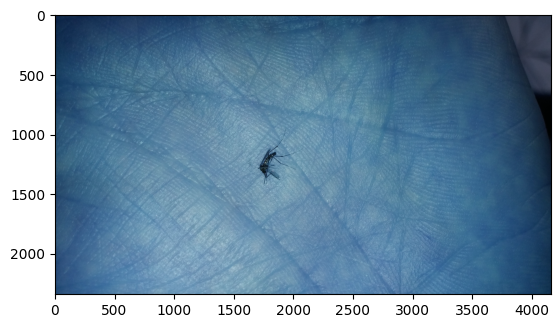

In [22]:
import cv2
import matplotlib.pyplot as plt
img  = cv2.imread("C:\\Users\\User\\Downloads\\Dewinter2023\\Final_yolov5x\\00a5c162-a7b9-4add-9148-129d4f91c4e2.jpeg")
plt.imshow(img)

In [15]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)

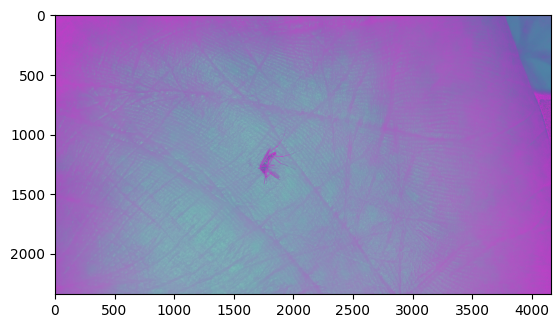

In [16]:
plt.imshow(img)
b,g,r =cv2.split(img)

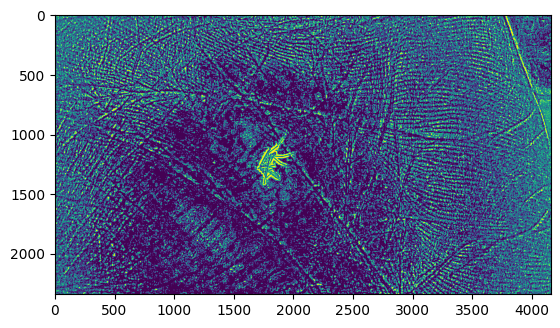

In [24]:
# Apply adaptive thresholding

binary_image = cv2.adaptiveThreshold(b, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 31, 2)
plt.imshow(binary_image)

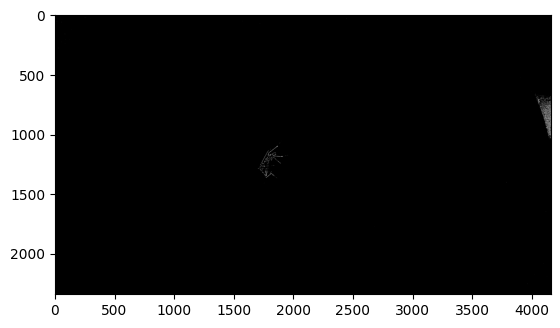

In [42]:
import numpy as np

# Convert binary_image to uint8 data type
binary_image_1 = np.uint8(binary_image)
thresholded,new_img =cv2.threshold(b,220,255,cv2.THRESH_BINARY)
plt.imshow(new_img,cmap='gray')